In [1]:
%%capture output
!pip install --upgrade pip
!pip install --upgrade pandas
!pip install tables   
# necessary for pd.read_hdf()

!pip install ipywidgets
!pip install --upgrade jupyter
!pip install IProgress
!pip install catboost
!pip install shap
!pip install anndata

In [2]:
import os
import random
import datetime
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.model_selection import KFold, GroupKFold
import scipy
import anndata as ad
import shap

/dss/dsshome1/02/di93zoj/.local/lib/python3.8/site-packages/cupy/_environment.py:445: UserWarning: 
--------------------------------------------------------------------------------

  CuPy may not function correctly because multiple CuPy packages are installed
  in your environment:

    cupy-cuda11x, cupy-cuda12x

  Follow these steps to resolve this issue:

    1. For all packages listed above, run the following command to remove all
       existing CuPy installations:

         $ pip uninstall <package_name>

      If you previously installed CuPy via conda, also run the following:

         $ conda uninstall cupy

    2. Install the appropriate CuPy package.
       Refer to the Installation Guide for detailed instructions.

         https://docs.cupy.dev/en/stable/install.html

--------------------------------------------------------------------------------

  warnings.warn(f'''


In [3]:
%matplotlib inline
from tqdm.notebook import tqdm
import gc
import pickle

import torch
import torch.nn as nn
from torch.nn import functional as F
from torch.utils.data import Dataset, DataLoader

device = torch.device("cuda")
pd.set_option('display.max_rows', 500)
pd.set_option('display.max_columns', 500)

## data load

In [4]:
lrz_path = '/dss/dssfs02/lwp-dss-0001/pn36po/pn36po-dss-0001/di93zoj/open-problems-multimodal-3rd-solution/'

model_path_for_now = '/dss/dsshome1/02/di93zoj/valentina/open-problems-multimodal-3rd-solution/'

raw_path =  lrz_path + 'input/raw/'  # '../../../input/raw/'

cite_target_path = lrz_path + 'input/target/cite/'   # '../../../input/target/cite/'
cite_feature_path = lrz_path + 'input/features/cite/'   # '../../../input/features/cite/'
cite_mlp_path = lrz_path + 'model/cite/mlp/'   # '../../../model/cite/mlp/'   # '../../../model/cite/mlp/'
cite_cb_path = lrz_path + 'model/cite/cb/'   # '../../../model/cite/cb/'

multi_target_path = lrz_path + 'input/target/multi/'   # '../../../input/target/multi/'
multi_feature_path = lrz_path + 'input/features/multi/'   # '../../../input/features/multi/'
multi_mlp_path = lrz_path + 'model/multi/mlp/'   # '../../../model/multi/mlp/'
multi_cb_path = lrz_path + 'model/multi/cb/'   # '../../../model/multi/cb/'

index_path = lrz_path + 'input/preprocess/cite/'

output_path = lrz_path + 'output/'   # '../../../output/'

## Cite

In [5]:
# get model name
#mlp_model_path = os.listdir(cite_mlp_path)

In [6]:
mlp_model_name = [
    'corr_add_con_imp',
    'corr_last_v3', 
    'corr_c_add_w2v_v1_mish_flg',
    'corr_c_add_w2v_v1_flg',
    'corr_c_add_84_v1',
    'corr_c_add_120_v1',
    'corr_w2v_cell_flg',
    'corr_best_cell_120',
    'corr_cluster_cell',
    'corr_w2v_128',
    'corr_imp_w2v_128',
    'corr_snorm',
    'corr_best_128',
    'corr_best_64',
    'corr_cluster_128',
    'corr_cluster_64',
    'corr_svd_128',
    'corr_svd_64',
             ]

In [7]:
model_name_list = []

for i in mlp_model_name:
    for num, j in enumerate(os.listdir(cite_mlp_path)):
        if i in j:
            model_name_list.append(j)

len(model_name_list)
model_name_list

['cite_mlp_corr_add_con_imp_flg_donor_val_50',
 'cite_mlp_corr_last_v3_flg_donor_val_55',
 'cite_mlp_corr_c_add_w2v_v1_mish_flg_donor_val_66',
 'cite_mlp_corr_c_add_w2v_v1_flg_donor_val_66',
 'cite_mlp_corr_c_add_84_v1_flg_donor_val_47',
 'cite_mlp_corr_c_add_120_v1_flg_donor_val_63',
 'cite_mlp_corr_w2v_cell_flg_donor_val_51',
 'cite_mlp_corr_best_cell_120_flg_donor_val_51',
 'cite_mlp_corr_cluster_cell_flg_donor_val_64',
 'cite_mlp_corr_w2v_128_flg_donor_val_42',
 'cite_mlp_corr_imp_w2v_128_flg_donor_val_38',
 'cite_mlp_corr_snorm_flg_donor_val_39',
 'cite_mlp_corr_best_128_flg_donor_val_45',
 'cite_mlp_corr_best_64_flg_donor_val_50',
 'cite_mlp_corr_cluster_128_flg_donor_val_51',
 'cite_mlp_corr_cluster_64_flg_donor_val_57',
 'cite_mlp_corr_svd_128_flg_donor_val_30',
 'cite_mlp_corr_svd_64_flg_donor_val_38']

In [8]:
weight = [1, 0.3, 1, 1, 1, 1, 1, 1, 1, 0.8, 0.8, 0.8, 0.8, 0.5, 0.5, 0.5, 1, 1, 2, 2]
weight_sum = np.array(weight).sum()
weight_sum

model_feat_dict = {model_name_list[0]:['X_test_add_con_imp.pickle', 1],
                   model_name_list[1]:['X_test_last_v3.pickle', 0.3],
                   model_name_list[2]:['X_test_c_add_w2v_v1.pickle', 1],
                   model_name_list[3]:['X_test_c_add_w2v_v1.pickle', 1],
                   model_name_list[4]:['X_test_c_add_84_v1.pickle', 1],
                   model_name_list[5]:['X_test_c_add_v1.pickle', 1],
                   
                   model_name_list[6]:['X_test_feature_w2v_cell.pickle', 1],
                   model_name_list[7]:['X_test_best_cell_128_120.pickle', 1],
                   model_name_list[8]:['X_test_cluster_cell_128.pickle', 1],
                   
                   model_name_list[9]:['X_test_feature_w2v.pickle', 0.8],
                   model_name_list[10]:['X_test_feature_imp_w2v.pickle',0.8],
                   model_name_list[11]:['X_test_feature_snorm.pickle', 0.8],
                   model_name_list[12]:['X_test_best_128.pickle', 0.8],
                   model_name_list[13]:['X_test_best_64.pickle', 0.5],
                   model_name_list[14]:['X_test_cluster_128.pickle', 0.5],
                   model_name_list[15]:['X_test_cluster_64.pickle', 0.5],
                   model_name_list[16]:['X_test_svd_128.pickle', 1],
                   model_name_list[17]:['X_test_svd_64.pickle', 1],
                   
                   'best_128':['X_test_best_128.pickle', 2],
                   'best_64':['X_test_best_64.pickle', 2],
                  }

### cite model

In [9]:
def std(x):
    x = np.array(x)
    return (x - x.mean(1).reshape(-1, 1)) / x.std(1).reshape(-1, 1)

In [10]:
class CiteDataset(Dataset):
    
    def __init__(self, feature, target):
        
        self.feature = feature
        self.target = target
        
    def __len__(self):
        return len(self.feature)
    
    def __getitem__(self, index):
                
        d = {
            "X": self.feature[index],
            "y" : self.target[index],
        }
        return d

In [11]:
class CiteDataset_test(Dataset):
    
    def __init__(self, feature):
        self.feature = feature
        
    def __len__(self):
        return len(self.feature)
    
    def __getitem__(self, index):
                
        d = {
            "X": self.feature[index]
        }
        return d

In [12]:
def partial_correlation_score_torch_faster(y_true, y_pred):
    """Compute the correlation between each rows of the y_true and y_pred tensors.
    Compatible with backpropagation.
    """
    y_true_centered = y_true - torch.mean(y_true, dim=1)[:,None]
    y_pred_centered = y_pred - torch.mean(y_pred, dim=1)[:,None]
    cov_tp = torch.sum(y_true_centered*y_pred_centered, dim=1)/(y_true.shape[1]-1)
    var_t = torch.sum(y_true_centered**2, dim=1)/(y_true.shape[1]-1)
    var_p = torch.sum(y_pred_centered**2, dim=1)/(y_true.shape[1]-1)
    return cov_tp/torch.sqrt(var_t*var_p)

def correl_loss(pred, tgt):
    """Loss for directly optimizing the correlation.
    """
    return -torch.mean(partial_correlation_score_torch_faster(tgt, pred))

In [13]:
class CiteModel(nn.Module):
    
    def __init__(self, feature_num):
        super(CiteModel, self).__init__()
        
        self.layer_seq_256 = nn.Sequential(nn.Linear(feature_num, 256),
                                           nn.Linear(256, 128),
                                       nn.LayerNorm(128),
                                       nn.ReLU(),
                                      )
        self.layer_seq_64 = nn.Sequential(nn.Linear(128, 64),
                                       nn.Linear(64, 32),
                                       nn.LayerNorm(32),
                                       nn.ReLU(),
                                      )
        self.layer_seq_8 = nn.Sequential(nn.Linear(32, 16),
                                         nn.Linear(16, 8),
                                       nn.LayerNorm(8),
                                       nn.ReLU(),
                                      )
        
        self.head = nn.Linear(128 + 32 + 8, 140)
                   
    def forward(self, X, y=None):
        
        from_numpy = False
        
      ##
        if isinstance(X, np.ndarray):
            X = torch.from_numpy(X)
            from_numpy = True
        X = X.to(device)  # Move the input to the appropriate device if necessary
        ##
        X_256 = self.layer_seq_256(X)
        X_64 = self.layer_seq_64(X_256)
        X_8 = self.layer_seq_8(X_64)
        
        X = torch.cat([X_256, X_64, X_8], axis = 1)
        out = self.head(X)
        
        if from_numpy:
            out = out.cpu().detach().numpy()
            
        return out

In [14]:
class CiteModel_mish(nn.Module):
    
    def __init__(self, feature_num):
        super(CiteModel_mish, self).__init__()
        
        self.layer_seq_256 = nn.Sequential(nn.Linear(feature_num, 256),
                                           nn.Linear(256, 128),
                                       nn.LayerNorm(128),
                                       nn.Mish(),
                                      )
        self.layer_seq_64 = nn.Sequential(nn.Linear(128, 64),
                                       nn.Linear(64, 32),
                                       nn.LayerNorm(32),
                                       nn.Mish(),
                                      )
        self.layer_seq_8 = nn.Sequential(nn.Linear(32, 16),
                                         nn.Linear(16, 8),
                                       nn.LayerNorm(8),
                                       nn.Mish(),
                                      )
        
        self.head = nn.Linear(128 + 32 + 8, 140)
                   
    def forward(self, X, y=None):
    
        X_256 = self.layer_seq_256(X)
        X_64 = self.layer_seq_64(X_256)
        X_8 = self.layer_seq_8(X_64)
        
        X = torch.cat([X_256, X_64, X_8], axis = 1)
        out = self.head(X)
        
        return out

In [15]:
def train_loop(model, optimizer, loader, epoch):
    
    losses, lrs = [], []
    model.train()
    optimizer.zero_grad()
    #loss_fn = nn.MSELoss()
    
    with tqdm(total=len(loader),unit="batch") as pbar:
        pbar.set_description(f"Epoch{epoch}")
        
        for d in loader:
            X = d['X'].to(device)
            y = d['y'].to(device)
            
            logits = model(X)
            loss = correl_loss(logits, y)
            #loss = torch.sqrt(loss_fn(logits, y))
        
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()
            
            pbar.set_postfix({"loss":loss.item()})
            pbar.update(1)

    return model

In [16]:
def valid_loop(model, loader, y_val):
    
    model.eval()
    partial_correlation_scores = []
    oof_pred = []
    
    for d in loader:
        with torch.no_grad():
            val_X = d['X'].to(device).float()
            val_y = d['y'].to(device)
            logits = model(val_X)
            oof_pred.append(logits)
    
    #print(torch.cat(oof_pred).shape, torch.cat(oof_pred).detach().cpu().numpy().shape)
    cor = partial_correlation_score_torch_faster(torch.tensor(y_val).to(device), torch.cat(oof_pred))
    cor = cor.mean().item()
    logits = torch.cat(oof_pred).detach().cpu().numpy()
    
    return logits, cor

In [17]:
def test_loop(model, loader):
    
    model.eval()
    predicts=[]

    for d in tqdm(loader):
        with torch.no_grad():
            X = d['X'].to(device)
            logits = model(X)
            predicts.append(logits.detach().cpu().numpy())
            
    return np.concatenate(predicts)

### pred

In [18]:
pred = np.zeros([48203, 140])

for num, i in enumerate(model_feat_dict.keys()):
    
    print(i)
    
    if 'mlp' in i:

        try:
            test_file = model_feat_dict[i][0]
            test_weight = model_feat_dict[i][1]
            X_test = pd.read_pickle(cite_feature_path  + test_file)   
            # print(cite_feature_path  + test_file)
            X_test = np.array(X_test)
            feature_dims = X_test.shape[1]

            test_ds = CiteDataset_test(X_test)
            test_dataloader = DataLoader(test_ds, batch_size=128, pin_memory=True, 
                                         shuffle=False, drop_last=False, num_workers=4)

            if 'mish' in i:
                model = CiteModel_mish(feature_dims)
            else:
                model = CiteModel(feature_dims)

            model = model.to(device)
            model.load_state_dict(torch.load(f'{cite_mlp_path}/{i}'))

            result = test_loop(model, test_dataloader).astype(np.float32)
            result = std(result) * test_weight / weight_sum
            pred += result

            torch.cuda.empty_cache()

        except Exception as e: 
            print(i)
            print(e)             # TODOOOOOOOOOOOOOO
        
    else:
        test_file = model_feat_dict[i][0]
        test_weight = model_feat_dict[i][1]
        X_test = pd.read_pickle(cite_feature_path  + test_file)
        
        cb_pred = np.zeros([48203, 140])
        
        for t in tqdm(range(140)): 
            cb_model_path = [j for j in os.listdir(cite_cb_path) if f'cb_{t}_{i}' in j][0]
            cb = pickle.load(open(cite_cb_path + cb_model_path, 'rb'))
            cb_pred[:,t] = cb.predict(X_test)
            
        cb_pred = cb_pred.astype(np.float32)
        pred += std(cb_pred) * test_weight / weight_sum
        
        del cb_pred

cite_mlp_corr_add_con_imp_flg_donor_val_50


  0%|          | 0/377 [00:00<?, ?it/s]

cite_mlp_corr_last_v3_flg_donor_val_55


  0%|          | 0/377 [00:00<?, ?it/s]

cite_mlp_corr_c_add_w2v_v1_mish_flg_donor_val_66


  0%|          | 0/377 [00:00<?, ?it/s]

cite_mlp_corr_c_add_w2v_v1_flg_donor_val_66


  0%|          | 0/377 [00:00<?, ?it/s]

cite_mlp_corr_c_add_84_v1_flg_donor_val_47


  0%|          | 0/377 [00:00<?, ?it/s]

cite_mlp_corr_c_add_120_v1_flg_donor_val_63


  0%|          | 0/377 [00:00<?, ?it/s]

cite_mlp_corr_w2v_cell_flg_donor_val_51


  0%|          | 0/377 [00:00<?, ?it/s]

cite_mlp_corr_best_cell_120_flg_donor_val_51


  0%|          | 0/377 [00:00<?, ?it/s]

cite_mlp_corr_cluster_cell_flg_donor_val_64


  0%|          | 0/377 [00:00<?, ?it/s]

cite_mlp_corr_w2v_128_flg_donor_val_42
cite_mlp_corr_w2v_128_flg_donor_val_42
pickle data was truncated
cite_mlp_corr_imp_w2v_128_flg_donor_val_38


  0%|          | 0/377 [00:00<?, ?it/s]

cite_mlp_corr_snorm_flg_donor_val_39


  0%|          | 0/377 [00:00<?, ?it/s]

cite_mlp_corr_best_128_flg_donor_val_45


  0%|          | 0/377 [00:00<?, ?it/s]

cite_mlp_corr_best_64_flg_donor_val_50


  0%|          | 0/377 [00:00<?, ?it/s]

cite_mlp_corr_cluster_128_flg_donor_val_51
cite_mlp_corr_cluster_128_flg_donor_val_51
pickle data was truncated
cite_mlp_corr_cluster_64_flg_donor_val_57


  0%|          | 0/377 [00:00<?, ?it/s]

cite_mlp_corr_svd_128_flg_donor_val_30


  0%|          | 0/377 [00:00<?, ?it/s]

cite_mlp_corr_svd_64_flg_donor_val_38


  0%|          | 0/377 [00:00<?, ?it/s]

best_128


  0%|          | 0/140 [00:00<?, ?it/s]

TBB Warning: The number of workers is currently limited to 9. The request for 79 workers is ignored. Further requests for more workers will be silently ignored until the limit changes.



best_64


  0%|          | 0/140 [00:00<?, ?it/s]

In [19]:
cite_sub = pd.DataFrame(pred.round(6))
cite_sub

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114,115,116,117,118,119,120,121,122,123,124,125,126,127,128,129,130,131,132,133,134,135,136,137,138,139
0,-0.325767,-0.487738,-0.351139,1.035394,0.867302,2.263471,3.314403,-0.490992,-0.422089,-0.312560,-0.516754,-0.479289,-0.392685,-0.437807,2.248444,-0.356812,1.858463,1.438221,0.311931,-0.459447,-0.390223,0.357044,-0.487529,-0.386469,2.933681,-0.493526,-0.496832,-0.490686,-0.519472,-0.486443,-0.499483,-0.456832,-0.462952,-0.465901,-0.445472,-0.486322,-0.406220,3.706107,-0.426987,-0.426969,-0.478369,-0.473534,-0.493516,-0.463637,-0.521282,-0.477247,-0.308790,-0.352572,2.829829,-0.491238,-0.471341,-0.467674,-0.427709,-0.501900,-0.094166,0.147856,-0.470777,1.119057,-0.465110,-0.468767,-0.465743,-0.437902,-0.412044,-0.464638,-0.483274,-0.425702,-0.353300,-0.406926,0.377374,-0.491446,-0.499591,-0.521969,-0.460512,3.233928,-0.502028,1.961053,-0.459225,0.279651,-0.455238,-0.469370,0.169536,-0.508457,-0.244526,-0.434981,-0.501910,-0.498316,-0.441767,-0.476339,-0.357719,-0.479157,-0.351639,-0.498732,-0.471366,-0.378029,0.257164,-0.401403,-0.442544,1.844755,-0.465230,1.572834,0.957418,-0.488895,1.072358,-0.422123,0.028856,-0.414253,1.396735,-0.268038,2.183714,-0.345104,-0.337413,0.395187,-0.390905,-0.465734,-0.479009,0.327426,-0.144475,-0.422026,-0.452289,2.622928,-0.450933,0.406673,-0.475251,-0.482181,-0.423303,-0.416871,-0.487996,-0.307121,-0.448958,-0.488162,-0.514007,1.841981,-0.389785,-0.518213,-0.500604,-0.341130,-0.016153,-0.317298,0.038913,0.358591
1,-0.293307,-0.470185,-0.351417,1.042340,0.918223,2.295353,3.557569,-0.485068,-0.415240,-0.313825,-0.507285,-0.467309,-0.390135,-0.437772,2.081140,-0.379274,1.817812,1.527190,0.218958,-0.443928,-0.396843,0.337870,-0.473521,-0.378367,2.997932,-0.475288,-0.487909,-0.482030,-0.519096,-0.478371,-0.486569,-0.440771,-0.453228,-0.449638,-0.432872,-0.484526,-0.406047,3.649258,-0.414698,-0.415922,-0.476712,-0.462437,-0.486182,-0.507216,-0.513429,-0.466063,-0.308042,-0.362187,2.793647,-0.483065,-0.458920,-0.464745,-0.472144,-0.494432,-0.116090,0.168782,-0.459241,0.760353,-0.473271,-0.456876,-0.456543,-0.430272,-0.406301,-0.449704,-0.480652,-0.419016,-0.357765,-0.404320,0.361015,-0.486164,-0.483510,-0.508212,-0.455934,3.269518,-0.497218,1.836228,-0.448956,0.262899,-0.452102,-0.455511,0.015679,-0.488521,-0.228284,-0.424335,-0.491802,-0.481530,-0.433237,-0.465633,-0.349264,-0.457304,-0.351280,-0.485360,-0.462076,-0.375112,0.195090,-0.387814,-0.433895,1.852686,-0.458732,1.629971,0.989916,-0.481465,1.042104,-0.415026,-0.026993,-0.408080,1.243898,-0.315948,2.307294,-0.338717,-0.338424,0.279150,-0.370051,-0.454253,-0.466977,0.202053,-0.207233,-0.402973,-0.442968,2.643998,-0.447381,0.725545,-0.461757,-0.474494,-0.407510,-0.405384,-0.473229,-0.275020,-0.438769,-0.481086,-0.503055,1.824850,-0.384038,-0.505780,-0.490800,-0.358872,-0.072174,-0.322904,0.059740,0.321151
2,-0.337575,-0.449081,-0.328770,1.541549,1.271137,1.486816,4.438023,-0.463581,-0.391279,-0.423727,-0.490480,-0.432064,-0.413590,-0.419570,3.426018,-0.273052,1.050578,1.232067,-0.147889,-0.459557,-0.391296,0.349071,-0.452589,-0.377862,2.946249,-0.457357,-0.465505,-0.456003,-0.552835,-0.449007,-0.464044,-0.396615,-0.427664,-0.421790,-0.406941,-0.461765,-0.376789,3.081319,-0.390267,-0.414918,-0.445042,-0.445852,-0.436071,-0.241519,-0.477286,-0.428363,-0.259145,-0.387482,0.834384,-0.462517,-0.428094,-0.450838,-0.397854,-0.472625,-0.105831,0.155859,-0.442649,0.735279,-0.463939,-0.440942,-0.214496,-0.391008,-0.372151,-0.421942,-0.428422,-0.395630,-0.315540,-0.405780,0.398103,-0.453094,-0.445499,-0.482222,-0.441426,1.487004,-0.439823,1.227368,-0.422020,0.056478,-0.423029,-0.428986,-0.157021,-0.457496,-0.1489

In [20]:
#cite_sub.to_csv('../../../../../summary/output/submit/cite_submit.csv')

In [21]:
# model #16: cite_mlp_corr_svd_128_flg_donor_val_30
pred_16 = np.zeros([48203, 140])

i = 'cite_mlp_corr_svd_128_flg_donor_val_30'
        
test_file = model_feat_dict[i][0]
test_weight = model_feat_dict[i][1]
X_test = pd.read_pickle(cite_feature_path  + test_file)
X_test = np.array(X_test)
feature_dims = X_test.shape[1]

test_ds = CiteDataset_test(X_test)
test_dataloader = DataLoader(test_ds, batch_size=128, pin_memory=True, 
                              shuffle=False, drop_last=False, num_workers=4)

if 'mish' in i:
    model = CiteModel_mish(feature_dims)
else:
    model = CiteModel(feature_dims)
    
model = model.to(device)
model.load_state_dict(torch.load(f'{cite_mlp_path}/{i}'))

result = test_loop(model, test_dataloader).astype(np.float32)
pred_16 += result

torch.cuda.empty_cache()
        
pd.DataFrame(pred_16)   # double check train_cite_targets.h5  -> omnipath

  0%|          | 0/377 [00:00<?, ?it/s]

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114,115,116,117,118,119,120,121,122,123,124,125,126,127,128,129,130,131,132,133,134,135,136,137,138,139
0,-1.066433,-1.500550,-1.354774,1.106190,0.869803,3.481040,5.067837,-1.570396,-1.444474,-1.320852,-1.612052,-1.534098,-1.428519,-1.496802,3.095008,-1.384286,2.648872,1.938160,-0.093022,-1.635664,-1.428120,-0.072564,-1.464633,-1.333522,4.528148,-1.577123,-1.570215,-1.564498,-1.633450,-1.551511,-1.606082,-1.488960,-1.542044,-1.542291,-1.515924,-1.584970,-1.483199,6.078822,-1.523234,-1.523154,-1.628240,-1.568818,-1.554284,-1.576391,-1.607019,-1.563618,-1.300677,-1.282699,4.529342,-1.497951,-1.504462,-1.616715,-1.604992,-1.590265,-0.913128,-0.373880,-1.571010,1.285669,-1.561719,-1.562544,-1.531397,-1.546362,-1.493735,-1.614805,-1.581547,-1.436415,-1.352806,-1.433268,0.004768,-1.507400,-1.582382,-1.650515,-1.553527,5.308838,-1.614917,2.937888,-1.565187,-0.132013,-1.512913,-1.525913,-0.179205,-1.617044,-1.141805,-1.497630,-1.589817,-1.619898,-1.517949,-1.527373,-1.324593,-1.536239,-1.349147,-1.607809,-1.596236,-1.449520,-0.069496,-1.395786,-1.459246,2.709844,-1.504532,2.281004,1.127239,-1.582563,1.390550,-1.485366,-0.814275,-1.483867,1.818746,-1.166362,3.551317,-1.324322,-1.333104,-0.007823,-1.370018,-1.791438,-1.608289,-0.100262,-0.915906,-1.476855,-1.569585,4.021511,-1.475899,0.135406,-1.601376,-1.499214,-1.508077,-1.504729,-1.617144,-1.285858,-1.497512,-1.602304,-1.585749,2.483784,-1.404202,-1.656756,-1.628249,-1.330432,-1.008113,-1.255932,-0.622936,-0.130905
1,-1.067110,-1.506955,-1.399289,1.075526,0.997081,3.506622,5.481764,-1.564466,-1.460833,-1.301538,-1.630497,-1.572419,-1.490347,-1.531179,3.168335,-1.427267,2.470253,2.130677,-0.441134,-1.637434,-1.472109,-0.058242,-1.472134,-1.346540,4.738451,-1.580705,-1.617835,-1.605957,-1.660571,-1.576319,-1.645333,-1.515913,-1.583853,-1.545092,-1.542181,-1.602096,-1.507277,6.134613,-1.544582,-1.598276,-1.658122,-1.569817,-1.591216,-1.618025,-1.622394,-1.573258,-1.365324,-1.374641,4.661467,-1.514943,-1.525232,-1.650555,-1.612984,-1.614313,-1.050634,-0.368892,-1.596666,0.777737,-1.589263,-1.581116,-1.578929,-1.556408,-1.516185,-1.611275,-1.630935,-1.470598,-1.411295,-1.485477,-0.118224,-1.505585,-1.588891,-1.651967,-1.588987,5.179552,-1.639723,2.675957,-1.584337,-0.139389,-1.552935,-1.552968,-0.562470,-1.613981,-1.148527,-1.525604,-1.601094,-1.632247,-1.561806,-1.547703,-1.396585,-1.549064,-1.390192,-1.631668,-1.603218,-1.467851,-0.253814,-1.409238,-1.494805,2.745513,-1.549431,2.249057,0.980224,-1.594142,1.342944,-1.517599,-0.857558,-1.512639,1.533982,-1.339978,3.737477,-1.391075,-1.371431,-0.343284,-1.380614,-1.574345,-1.623899,-0.251694,-1.224326,-1.529244,-1.581402,4.151693,-1.492653,0.829439,-1.611794,-1.553943,-1.531965,-1.514008,-1.643932,-1.266751,-1.511899,-1.586327,-1.620505,2.777343,-1.404117,-1.657573,-1.687846,-1.422966,-0.780818,-1.299758,-0.628505,-0.121618
2,-1.010656,-1.271471,-1.207577,2.074188,1.614956,2.007590,6.589465,-1.374983,-1.260541,-1.450437,-1.464440,-1.332187,-1.378543,-1.357404,4.944262,-1.135714,0.924946,1.518677,-0.864071,-1.520523,-1.308277,0.001427,-1.352170,-1.241024,4.492778,-1.413115,-1.387910,-1.474926,-1.551057,-1.376167,-1.415526,-1.233463,-1.391570,-1.319213,-1.332545,-1.431528,-1.287814,4.748064,-1.345603,-1.431643,-1.396456,-1.397756,-1.360939,-1.085002,-1.420398,-1.334369,-1.064852,-1.288315,1.083776,-1.353123,-1.357820,-1.394112,-1.357486,-1.375918,-0.872777,-0.296593,-1.410997,0.365104,-1.434169,-1.399326,-0.980195,-1.282730,-1.286808,-1.391266,-1.348446,-1.279712,-1.213837,-1.296896,0.074692,-1.323143,-1.357035,-1.430854,-1.481354,2.077808,-1.360545,1.681203,-1.313775,-0.382094,-1.374308,-1.361059,-0.

### prediction with private test input -> should get private test target

In [23]:
private_test_input = ad.read('/dss/dssfs02/lwp-dss-0001/pn36po/pn36po-dss-0001/di93zoj/large_preprocessed_files/private_test_input.h5ad')
private_test_input

AnnData object with n_obs × n_vars = 26867 × 22085
    obs: 'kaggle_dataset', 'day', 'donor', 'cell_type'

In [24]:
private_test_target = ad.read('/dss/dssfs02/lwp-dss-0001/pn36po/pn36po-dss-0001/di93zoj/large_preprocessed_files/private_test_target.h5ad')
private_test_target

AnnData object with n_obs × n_vars = 26867 × 140
    obs: 'kaggle_dataset', 'day', 'donor', 'cell_type'

In [25]:
private_test_target_raw = ad.read('/dss/dssfs02/lwp-dss-0001/pn36po/pn36po-dss-0001/di93zoj/large_preprocessed_files/private_test_target_raw.h5ad')
private_test_target_raw

AnnData object with n_obs × n_vars = 26867 × 140
    obs: 'kaggle_dataset', 'day', 'donor', 'cell_type'

In [26]:
with open('private_X_test_svd.pkl', 'rb') as f:  # private_X_test_svd

    private_X_test_svd = pickle.load(f)
private_X_test_svd.shape

(26867, 212)

In [27]:
with open('private_X_test_svd_from_raw.pkl', 'rb') as f:  # private_X_test_svd

    private_X_test_svd_from_raw = pickle.load(f)
private_X_test_svd_from_raw.shape

(26867, 212)

In [28]:
# model #16: cite_mlp_corr_svd_128_flg_donor_val_30
pred_16 = np.zeros([26867, 140])

i = 'cite_mlp_corr_svd_128_flg_donor_val_30'
        
# test_file = model_feat_dict[i][0]
# test_weight = model_feat_dict[i][1]
X_test = private_X_test_svd_from_raw
X_test = np.array(X_test)
feature_dims = X_test.shape[1]

test_ds = CiteDataset_test(X_test)
test_dataloader = DataLoader(test_ds, batch_size=128, pin_memory=True, 
                              shuffle=False, drop_last=False, num_workers=4)

if 'mish' in i:
    model = CiteModel_mish(feature_dims)
else:
    model = CiteModel(feature_dims)
    
model = model.to(device)
model.load_state_dict(torch.load(f'{cite_mlp_path}/{i}'))

result = test_loop(model, test_dataloader).astype(np.float32)
pred_16 += result

torch.cuda.empty_cache()
        
pd.DataFrame(pred_16)

  0%|          | 0/210 [00:00<?, ?it/s]

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114,115,116,117,118,119,120,121,122,123,124,125,126,127,128,129,130,131,132,133,134,135,136,137,138,139
0,-0.484765,-1.336785,-1.234908,0.420207,-0.379709,1.438010,4.400939,-1.501436,-1.294824,-0.674522,-1.447717,-1.513483,-1.432106,-1.446688,2.120866,0.764068,0.464796,-1.600400,-1.595209,-1.697857,-1.460631,-1.315127,-1.290099,-1.244657,3.515849,-1.351885,-1.447201,-1.364279,-0.972907,-1.390103,-1.545987,-1.388353,-1.456311,-1.382345,-1.410964,-1.426121,-1.404616,2.484143,-1.334834,-1.468333,-1.419670,-1.384126,-1.427339,4.096226,-1.482539,-1.428680,-1.266487,-1.271319,0.774478,-1.429024,-1.468217,-1.415502,-1.022006,-1.519049,-1.217874,-1.376503,-1.393057,-1.149647,-1.578505,-1.042522,-1.490308,-1.342847,-1.417471,-1.370524,-0.658926,-1.363249,-1.316571,-1.305867,-0.532632,-0.907684,-1.412771,-1.426331,-1.495820,4.132032,-1.433610,0.446555,-1.385205,-0.417923,-1.520695,-1.468561,0.238597,-1.394669,-1.173231,-1.360571,-1.464217,-1.417430,-1.176608,-1.325643,1.328878,-0.954482,-1.311810,-1.365109,-1.314409,-1.403220,-1.292152,-1.220580,-1.312031,1.638292,-1.401461,1.500397,-0.117206,-1.555998,2.480597,-1.451071,-1.277916,-1.362213,1.360252,-1.598755,-0.354577,1.218363,-1.143524,-0.524095,-1.306737,-1.425508,-1.209010,-1.526528,-0.096362,-1.478315,-1.379103,2.654458,-1.364117,1.226758,-1.410380,-1.536312,-1.297039,-1.322737,-1.454899,-1.400248,-1.425289,-1.095249,-1.478929,2.398230,-1.353355,-1.410040,-1.143927,-1.288544,1.905234,-0.873288,-1.015901,-0.020093
1,-1.312432,-1.331409,-1.195820,0.628265,1.191234,2.389101,-0.317082,-1.383621,-1.324418,-0.918696,-1.397497,-1.385186,-1.274490,-1.296118,2.005127,-1.151529,2.034677,-0.328693,0.611304,-1.399846,-1.229430,-0.051986,-1.288918,-1.150828,4.057484,-1.381030,-1.446418,-1.393163,-1.467374,-1.371263,-1.458442,-1.302962,-1.362834,-1.342565,-1.313212,-1.378140,-1.324571,7.054258,-1.310450,-1.368348,-1.498659,-1.295473,-1.479542,-1.016833,-1.447213,-1.404496,-1.205671,-1.301525,3.422641,-1.413202,-1.351846,-1.459216,-1.174409,-1.454688,-0.956385,-0.619219,-1.354969,0.494956,-1.400455,-1.386513,-1.474475,-1.365298,-1.345301,-1.383618,-1.414419,-1.352348,-1.259663,-1.077464,-0.209498,-1.376186,-1.354610,-1.442186,-1.372097,4.770603,-1.402416,5.072682,-1.410140,-0.517170,-1.355470,-1.433456,0.095147,-1.369437,-1.197025,-1.306331,-1.424332,-1.428103,-1.394183,-1.365584,-1.187633,-1.232063,-1.241544,-1.429945,-1.362820,-1.292890,0.488681,-1.360426,-1.296737,2.077759,-1.364896,2.094314,0.380662,-1.457947,1.205054,-1.296322,-0.490482,-1.328193,2.359329,-1.278035,1.296358,-1.029840,-1.175934,0.081408,-1.234390,-1.103826,-1.393443,0.381933,-1.228765,-1.294166,-1.422023,1.927439,-1.293624,5.116095,-1.388127,-1.423291,-1.240960,-1.305189,-1.384535,-1.257691,-1.274874,-1.270746,-1.409953,1.570238,-1.277861,-1.457082,-1.449697,-1.333568,0.616073,-1.264038,-0.737135,-0.253122
2,-0.577386,-1.106494,-1.005129,0.389789,-0.242458,2.658759,1.365518,-1.257949,-1.118716,-0.919354,-1.187686,-1.205850,-1.055683,-1.313327,3.130444,-0.127890,1.454334,-1.393169,-1.183770,-1.227264,-1.256809,-0.923715,-1.087219,-0.907194,0.502842,-1.207453,-1.287691,-1.108216,-0.693255,-1.152888,-1.273641,-1.169763,-1.215152,-1.182430,-1.138713,-1.172424,-1.223194,3.501707,-1.146673,-1.294073,-1.140554,-1.213602,-1.211851,4.552234,-1.196259,-1.175674,-1.107780,-0.992354,1.569297,-1.196482,-1.216214,-1.095384,-1.476511,-1.291856,-0.870548,-0.666804,-1.256428,-0.828065,-1.222265,-1.035687,-1.013073,-1.169843,-1.206055,-1.252804,0.334249,-1.098134,-1.060981,-1.127804,-0.242513,-0.241963,-1.208853,-1.215300,-1.251280,0.621707,-1.170656,2.151747,-1.161287,-0.242333,-1.144696,-1.123101,0.29

In [29]:
pd.DataFrame(private_test_target.X)

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114,115,116,117,118,119,120,121,122,123,124,125,126,127,128,129,130,131,132,133,134,135,136,137,138,139
0,8.875269,1.072714,0.349734,2.983766,3.551555,10.595364,17.327169,-0.144145,1.184181,3.041042,-0.429325,1.182045,0.099277,0.779827,8.188025,-0.270990,8.430601,1.836533,0.745340,-0.351743,0.439735,0.765868,1.125316,1.748645,19.122791,-0.242279,0.408039,2.850391,1.086136,-1.090475,0.438324,0.488942,-0.207521,0.550487,1.475966,1.382768,0.295792,8.440279,-0.722296,-0.775979,0.062518,0.936198,0.994711,18.807247,0.172296,0.722737,0.910600,0.162670,6.142643,0.404690,0.376773,1.482086,5.648309,-0.472074,0.724059,1.284304,-0.434013,0.619052,0.485545,3.045351,-0.635869,-0.436930,0.655264,0.467037,0.579335,-0.508544,0.959657,-0.067105,1.270376,0.234640,0.066366,0.192507,-0.682262,17.483824,-0.892266,10.238394,1.745744,2.714039,-0.701813,0.747299,0.877073,1.563599,1.058956,-0.457277,1.228947,0.388389,-0.010542,0.267340,5.669645,7.474632,1.808860,-0.199814,1.059669,-1.377614,0.698028,2.975605,0.312312,7.067345,0.448233,3.165192,1.711047,-0.512108,13.989281,-0.319555,1.991211,1.292144,8.198327,-0.497042,1.667113,0.175193,0.952262,2.701510,0.315933,1.213420,-0.912409,-0.586749,3.214163,-0.050946,0.610855,9.844093,-1.327427,6.832107,0.191609,-0.512926,0.011371,-0.843791,0.625344,1.954184,0.247891,1.342433,0.191373,11.086969,0.300469,0.805080,-0.291616,1.635413,7.509739,6.417010,-0.497571,3.759374
1,-0.331542,0.871559,0.484194,-0.784014,4.173365,5.242312,3.511576,1.208851,0.547345,-1.133742,1.118824,1.442501,0.455243,0.283438,6.993079,-0.026130,10.230215,2.101537,3.080711,-0.216307,0.533936,-0.498301,2.256030,0.834251,9.049059,0.779667,0.682752,0.573576,0.962821,0.293053,-0.178916,0.821061,0.655331,0.348021,-0.402928,0.473780,1.412509,16.912354,0.567827,-0.521395,-0.492781,0.638112,0.850088,-0.706945,0.518396,0.035253,1.234597,-0.144053,5.296485,0.349541,-0.509136,0.525733,0.911987,-0.256126,1.823956,1.146885,1.171728,3.219068,-0.451023,-0.466942,-0.415797,0.597951,-0.374317,1.043082,-0.423951,-0.193910,-0.043685,-0.116682,1.089144,1.671674,-0.377057,0.667307,0.713002,5.564362,-0.546455,9.313555,0.059604,1.048921,-0.461957,-0.665786,2.390503,-0.422717,-1.041684,1.245956,0.860920,1.365275,1.652736,1.011294,1.224288,0.010108,0.349052,-0.914434,0.693691,-0.017469,2.352008,-0.068106,0.663223,4.722332,-0.148873,3.343668,3.256628,-0.358878,2.278013,-1.183820,-0.309653,-0.683214,5.749076,1.312526,5.519828,0.472522,2.021698,2.179903,-0.207124,0.175539,-0.611545,2.168428,1.053179,0.262963,0.815993,-0.660271,1.183417,9.385386,2.176677,-0.303985,0.339248,-0.497396,0.404140,0.547107,0.947232,0.477131,0.310369,7.197814,-0.425260,-0.154081,-0.124246,-0.106671,3.812726,-0.155547,1.029169,3.598739
2,-0.211242,0.736260,1.096481,1.892444,1.585475,3.669683,2.232614,-1.042255,0.724554,0.833527,0.654052,1.568456,1.693014,1.225370,2.855914,0.092283,0.469575,1.260003,2.548044,-0.150811,0.455052,1.280808,-0.480674,0.291739,2.320207,0.187424,1.809985,0.079923,1.468113,1.157402,0.739877,-0.197212,-0.863157,1.058822,-0.267103,-0.118149,-0.085934,5.851235,-0.486316,-0.398280,0.354495,-0.619301,-0.555109,3.469603,-0.162294,-0.094670,1.391279,0.013668,-0.517603,0.099101,0.738166,1.355466,-0.590801,1.464079,6.004411,0.804768,0.427432,1.580613,0.833697,0.736071,2.144272,1.333905,-0.193387,1.040795,10.899550,1.741197,0.114915,0.051703,2.828831,0.678737,0.498896,0.860332,-0.265413,2.195580,0.749844,2.715751,0.203019,2.059091,0.831223,1.163601,1.132976,0.591543,0.990607,0.081153,2.316111,1.534367,0.996560,2.787698,0.651980,0.108140,0.825298,1.685943,-0.054280,0.446149,1.579761,0.015828,1.739001,6.939562,-1.162202,4.748300,0.575198,-0.

In [30]:
pd.DataFrame(private_test_target_raw.X.toarray())

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114,115,116,117,118,119,120,121,122,123,124,125,126,127,128,129,130,131,132,133,134,135,136,137,138,139
0,10.0,8.0,11.0,7.0,30.0,15.0,21.0,2.0,23.0,9.0,1.0,1.0,4.0,2.0,6.0,0.0,14.0,9.0,2.0,0.0,12.0,8.0,2.0,4.0,23.0,1.0,1.0,7.0,17.0,11.0,10.0,3.0,2.0,3.0,2.0,9.0,4.0,6.0,4.0,0.0,4.0,3.0,5.0,60.0,4.0,10.0,2.0,2.0,6.0,5.0,14.0,9.0,11.0,0.0,5.0,22.0,4.0,3.0,1.0,4.0,0.0,28.0,12.0,12.0,1.0,1.0,3.0,4.0,9.0,2.0,39.0,36.0,0.0,23.0,5.0,20.0,4.0,9.0,0.0,2.0,1.0,3.0,13.0,2.0,3.0,2.0,8.0,4.0,28.0,21.0,13.0,11.0,46.0,3.0,5.0,1.0,3.0,25.0,7.0,7.0,11.0,0.0,7.0,2.0,6.0,3.0,13.0,0.0,27.0,1.0,10.0,8.0,4.0,1.0,0.0,0.0,9.0,1.0,1.0,16.0,0.0,18.0,1.0,0.0,4.0,1.0,3.0,9.0,5.0,9.0,13.0,22.0,3.0,36.0,0.0,11.0,48.0,39.0,5.0,17.0
1,0.0,6.0,10.0,0.0,34.0,6.0,3.0,4.0,16.0,0.0,3.0,1.0,4.0,1.0,5.0,0.0,18.0,9.0,5.0,0.0,11.0,3.0,3.0,2.0,8.0,2.0,1.0,2.0,14.0,17.0,6.0,3.0,3.0,2.0,0.0,5.0,6.0,15.0,7.0,0.0,2.0,2.0,4.0,0.0,4.0,6.0,2.0,1.0,5.0,4.0,8.0,5.0,2.0,0.0,7.0,19.0,8.0,8.0,0.0,0.0,0.0,35.0,6.0,13.0,0.0,1.0,1.0,3.0,7.0,4.0,29.0,37.0,1.0,5.0,5.0,17.0,1.0,4.0,0.0,0.0,2.0,0.0,3.0,5.0,2.0,3.0,14.0,5.0,6.0,1.0,6.0,6.0,36.0,6.0,9.0,0.0,3.0,14.0,4.0,7.0,17.0,0.0,1.0,0.0,1.0,0.0,8.0,1.0,153.0,1.0,13.0,6.0,2.0,0.0,0.0,2.0,3.0,1.0,1.0,0.0,4.0,28.0,3.0,0.0,4.0,1.0,2.0,4.0,6.0,5.0,12.0,12.0,1.0,22.0,0.0,4.0,18.0,3.0,9.0,15.0
2,0.0,5.0,12.0,4.0,15.0,4.0,2.0,0.0,16.0,3.0,2.0,1.0,7.0,2.0,2.0,0.0,1.0,6.0,4.0,0.0,10.0,8.0,0.0,1.0,2.0,1.0,2.0,1.0,16.0,22.0,9.0,1.0,0.0,3.0,0.0,3.0,2.0,4.0,3.0,0.0,4.0,0.0,1.0,5.0,2.0,5.0,2.0,1.0,0.0,3.0,13.0,7.0,0.0,1.0,24.0,16.0,5.0,4.0,1.0,1.0,2.0,42.0,6.0,12.0,14.0,4.0,1.0,3.0,13.0,2.0,37.0,37.0,0.0,2.0,9.0,4.0,1.0,6.0,1.0,2.0,1.0,1.0,10.0,2.0,4.0,3.0,10.0,10.0,4.0,1.0,7.0,19.0,26.0,7.0,6.0,0.0,5.0,23.0,1.0,10.0,5.0,0.0,2.0,4.0,2.0,0.0,6.0,0.0,152.0,20.0,8.0,36.0,0.0,0.0,2.0,0.0,4.0,1.0,0.0,11.0,2.0,6.0,0.0,0.0,2.0,3.0,2.0,8.0,6.0,2.0,9.0,15.0,5.0,29.0,0.0,6.0,7.0,5.0,7.0,8.0
3,4.0,8.0,11.0,5.0,40.0,10.0,13.0,4.0,29.0,2.0,5.0,0.0,5.0,1.0,7.0,0.0,3.0,6.0,3.0,0.0,18.0,7.0,1.0,5.0,9.0,3.0,1.0,2.0,13.0,24.0,6.0,4.0,2.0,3.0,2.0,6.0,6.0,2.0,8.0,0.0,3.0,2.0,5.0,24.0,6.0,9.0,1.0,2.0,3.0,3.0,12.0,3.0,3.0,0.0,6.0,14.0,5.0,6.0,1.0,0.0,3.0,41.0,15.0,11.0,3.0,4.0,0.0,4.0,12.0,2.0,49.0,37.0,1.0,28.0,7.0,0.0,1.0,4.0,0.0,1.0,3.0,4.0,12.0,3.0,1.0,2.0,10.0,3.0,13.0,2.0,5.0,9.0,49.0,5.0,9.0,0.0,2.0,28.0,4.0,7.0,6.0,0.0,4.0,3.0,2.0,0.0,5.0,0.0,47.0,14.0,10.0,8.0,7.0,1.0,1.0,0.0,4.0,1.0,0.0,11.0,1.0,7.0,1.0,0.0,3.0,1.0,0.0,5.0,3.0,7.0,11.0,10.0,5.0,34.0,0.0,6.0,39.0,13.0,10.0,15.0
4,0.0,3.0,10.0,1.0,14.0,3.0,3.0,2.0,11.0,2.0,0.0,0.0,2.0,0.0,3.0,0.0,1.0,2.0,2.0,0.0,4.0,5.0,1.0,1.0,4.0,0.0,0.0,0.0,3.0,9.0,2.0,1.0,3.0,1.0,0.0,2.0,3.0,1.0,4.0,1.0,3.0,2.0,2.0,3.0,5.0,11.0,0.0,4.0,1.0,0.0,5.0,2.0,0.0,1.0,3.0,11.0,2.0,1.0,0.0,0.0,0.0,27.0,7.0,4.0,0.0,1.0,2.0,1.0,7.0,2.0,22.0,17.0,1.0,0.0,8.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,4.0,0.0,1.0,0.0,1.0,2.0,0.0,0.0,7.0,4.0,23.0,3.0,6.0,0.0,0.0,15.0,2.0,2.0,7.0,0.0,0.0,3.0,14.0,0.0,2.0,0.0,34.0,1.0,5.0,0.0,1.0,0.0,0.0,1.0,0.0,1.0,2.0,8.0,0.0,0.0,0.0,1.0,0.0,0.0,2.0,7.0,3.0,2.0,7.0,3.0,1.0,15.0,0.0,6.0,8.0,1.0,6.0,18.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
26862,0.0,6.0,4.0,11.0,31.0

In [31]:
pd.concat([pd.DataFrame(pred_16), pd.DataFrame(private_test_target.X)]).corr().head()

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114,115,116,117,118,119,120,121,122,123,124,125,126,127,128,129,130,131,132,133,134,135,136,137,138,139
0,1.000000,0.395669,0.483408,0.488264,0.477773,0.429052,0.566816,0.323234,0.464535,0.501602,0.482766,0.408244,0.477250,0.441145,0.520438,0.446120,0.429431,0.413282,0.402171,0.337965,0.441410,0.141506,0.415503,0.499274,0.459079,0.493078,0.463867,0.498512,0.495758,0.497030,0.490012,0.429719,0.483207,0.476248,0.438478,0.478820,0.433683,0.260158,0.452913,0.416330,0.435619,0.438191,0.484492,0.404008,0.491952,0.492421,0.359967,0.379979,0.301469,0.488284,0.459609,0.478537,0.455014,0.449035,0.408021,0.478971,0.470944,0.427142,0.446146,0.472947,0.490029,0.526877,0.460415,0.489742,0.412616,0.413162,0.348802,0.442170,0.393929,0.483109,0.519561,0.521708,0.436926,0.475813,0.488602,0.292039,0.442170,0.374262,0.431792,0.241839,0.484195,0.209908,0.533824,0.443940,0.482815,0.488575,0.515723,0.497851,0.390620,0.022936,0.422553,0.516082,0.518356,0.437861,0.481706,0.302802,0.346569,0.495138,0.485233,0.277826,0.484969,0.431210,0.401646,0.423084,0.284657,0.464332,0.520663,0.425381,0.231320,0.428299,0.334862,0.416166,0.484221,0.045695,0.526755,0.359470,0.383579,0.478113,0.466129,0.483809,0.462295,0.165481,0.446337,0.404827,0.450653,0.447470,0.476096,0.528573,0.486120,0.464129,0.484039,0.474103,0.417733,0.519616,0.409648,0.472714,0.407666,0.550892,0.200721,0.393039
1,0.395669,1.000000,0.746622,0.575627,0.723880,0.667003,0.172938,0.741555,0.733831,0.595802,0.638539,0.578936,0.658260,0.630484,0.280495,0.228621,0.598998,0.332825,0.484136,0.487902,0.668161,0.716688,0.635515,0.635909,0.278187,0.609422,0.629152,0.639810,0.642756,0.717656,0.717845,0.621513,0.668676,0.646064,0.602503,0.676333,0.664232,0.630006,0.718724,0.637160,0.629878,0.629554,0.648044,0.532151,0.640098,0.713152,0.566501,0.759951,0.176878,0.677851,0.695723,0.687360,0.566555,0.590644,0.680238,0.677953,0.689352,0.452046,0.583545,0.591108,0.489226,0.700364,0.708384,0.720770,0.371190,0.611794,0.573622,0.672325,0.681164,0.427318,0.733042,0.729567,0.623505,0.207042,0.672603,0.432422,0.652245,0.404376,0.625941,0.737245,0.238030,0.714350,0.699148,0.690668,0.629014,0.632924,0.693314,0.683341,0.570113,0.580825,0.670754,0.706894,0.751393,0.707699,0.551552,0.481998,0.782548,0.737967,0.688871,0.617967,0.618359,0.586544,0.208264,0.650952,0.355633,0.618192,0.544771,0.587298,0.424412,0.331822,0.518739,0.670601,0.465140,0.520835,0.554927,0.318087,0.518064,0.622578,0.468386,0.380995,0.676549,0.567254,0.630332,0.591158,0.657922,0.663050,0.652000,0.584708,0.695618,0.747702,0.670902,0.452958,0.624643,0.716503,0.338747,0.735621,0.406887,0.477481,0.414640,0.658691
2,0.483408,0.746622,1.000000,0.621547,0.693663,0.596770,0.287629,0.671602,0.815657,0.668238,0.690057,0.651008,0.730867,0.703806,0.428624,0.322205,0.568021,0.406425,0.546555,0.537525,0.756375,0.582961,0.657365,0.686821,0.417182,0.679181,0.683047,0.693969,0.736968,0.803143,0.787063,0.707430,0.725986,0.711906,0.662414,0.736273,0.755528,0.483741,0.792542,0.689833,0.699645,0.714330,0.726879,0.478732,0.694275,0.771409,0.671429,0.665529,0.255545,0.746812,0.793852,0.760781,0.616719,0.646954,0.748566,0.715564,0.767617,0.546022,0.650030,0.658417,0.562305,0.789693,0.795482,0.798212,0.447375,0.710573,0.684138,0.751747,0.744213,0.509072,0.808306,0.804600,0.685271,0.335996,0.738999,0.517030,0.722997,0.541703,0.675274,0.563407,0.339023,0.515474,0.768457,0.753326,0.684555,0.698054,0.782506,0.741403,0.631268,0.356916,0.771867,0.776911,0.827655,0.787617,0.581479,0.478580,0.708955,0.731530,0.759596,0.494265,0.638468,0.644143,0.313197,0.739695,0.457568,0.699670,0.586008,0.655927,0.571842,0.454210,0.668346,0.653507,0.571339,0.3566

In [ ]:
# TODO check svd output to see if svd model is correct

### add cell_ids and cell_type to train and test data

In [32]:
train_ids = np.load(index_path + "train_cite_raw_inputs_idxcol.npz", allow_pickle=True)
test_ids = np.load(index_path + "test_cite_raw_inputs_idxcol.npz", allow_pickle=True)

train_index = train_ids["index"]
train_column = train_ids["columns"]
test_index = test_ids["index"]
print(len(list(train_index)))
print(len(list(test_index)))
X_train_cell_ids = pd.read_pickle(cite_feature_path  + 'X_svd_128.pickle')   # = X_svd_128 in make-features second to last cell
X_train_cell_ids.index = train_index
X_train_cell_ids

70988
48203


,base_svd_0,base_svd_1,base_svd_2,base_svd_3,base_svd_4,base_svd_5,base_svd_6,base_svd_7,base_svd_8,base_svd_9,base_svd_10,base_svd_11,base_svd_12,base_svd_13,base_svd_14,base_svd_15,base_svd_16,base_svd_17,base_svd_18,base_svd_19,base_svd_20,base_svd_21,base_svd_22,base_svd_23,base_svd_24,base_svd_25,base_svd_26,base_svd_27,base_svd_28,base_svd_29,base_svd_30,base_svd_31,base_svd_32,base_svd_33,base_svd_34,base_svd_35,base_svd_36,base_svd_37,base_svd_38,base_svd_39,base_svd_40,base_svd_41,base_svd_42,base_svd_43,base_svd_44,base_svd_45,base_svd_46,base_svd_47,base_svd_48,base_svd_49,base_svd_50,base_svd_51,base_svd_52,base_svd_53,base_svd_54,base_svd_55,base_svd_56,base_svd_57,base_svd_58,base_svd_59,base_svd_60,base_svd_61,base_svd_62,base_svd_63,base_svd_64,base_svd_65,base_svd_66,base_svd_67,base_svd_68,base_svd_69,base_svd_70,base_svd_71,base_svd_72,base_svd_73,base_svd_74,base_svd_75,base_svd_76,base_svd_77,base_svd_78,base_svd_79,base_svd_80,base_svd_81,base_svd_82,base_svd_83,base_svd_84,base_svd_85,base_svd_86,base_svd_87,base_svd_88,base_svd_89,base_svd_90,base_svd_91,base_svd_92,base_svd_93,base_svd_94,base_svd_95,base_svd_96,base_svd_97,base_svd_98,base_svd_99,base_svd_100,base_svd_101,base_svd_102,base_svd_103,base_svd_104,base_svd_105,base_svd_106,base_svd_107,base_svd_108,base_svd_109,base_svd_110,base_svd_111,base_svd_112,base_svd_113,base_svd_114,base_svd_115,base_svd_116,base_svd_117,base_svd_118,base_svd_119,base_svd_120,base_svd_121,base_svd_122,base_svd_123,base_svd_124,base_svd_125,base_svd_126,base_svd_127,imp_0,imp_1,imp_2,imp_3,imp_4,imp_5,imp_6,imp_7,imp_8,imp_9,imp_10,imp_11,imp_12,imp_13,imp_14,imp_15,imp_16,imp_17,imp_18,imp_19,imp_20,imp_21,imp_22,imp_23,imp_24,imp_25,imp_26,imp_27,imp_28,imp_29,imp_30,imp_31,imp_32,imp_33,imp_34,imp_35,imp_36,imp_37,imp_38,imp_39,imp_40,imp_41,imp_42,imp_43,imp_44,imp_45,imp_46,imp_47,imp_48,imp_49,imp_50,imp_51,imp_52,imp_53,imp_54,imp_55,imp_56,imp_57,imp_58,imp_59,imp_60,imp_61,imp_62,imp_63,imp_64,imp_65,imp_66,imp_67,imp_68,imp_69,imp_70,imp_71,imp_72,imp_73,imp_74,imp_75,imp_76,imp_77,imp_78,imp_79,imp_80,imp_81,imp_82,imp_83
45006fe3e4c8,85.125969,-5.213882,-9.165653,2.846810,-8.684980,1.042275,1.625518,0.619070,-2.840409,0.843441,4.115829,0.024965,-1.137678,-2.111087,0.099981,1.337295,-0.596183,-0.751670,1.757503,1.105504,0.548275,1.499717,1.038158,-0.272647,-1.365031,1.203716,-0.039632,-0.671083,-0.348216,0.808329,-1.088297,1.166704,0.027755,1.366436,0.973908,0.773016,-0.174528,-0.523925,0.453909,-0.728664,-0.456345,-1.645094,0.447493,-0.671825,0.430144,-0.280060,0.881533,0.561494,-1.220469,0.560754,-0.231062,0.496692,-0.943169,0.868538,-0.154141,0.078856,-0.070176,-0.007819,0.074339,0.573376,0.785706,-0.906731,-0.645871,-0.845648,-1.005128,0.176227,-0.169867,0.497778,0.960643,0.613253,0.228263,1.839634,0.320640,-0.114535,0.429554,0.472934,0.209707,0.399535,-0.220862,-0.737181,-0.358094,0.873111,0.333368,-0.584062,1.558778,-0.176269,-0.358608,-0.733838,-0.788332,1.894175,1.065095,-0.152460,0.532643,0.649301,-0.675917,-0.055446,-0.356519,-0.083569,0.379331,0.506132,0.040859,-0.131479,-0.083956,-0.473989,0.716725,0.105041,1.005419,0.055210,-1.100018,-0.658857,-0.431340,0.944570,-0.604597,0.623689,0.026247,-0.797958,-0.638471,0.707517,1.439186,-0.069983,0.057408,0.690074,-0.355250,-0.564387,-0.570264,-0.346299,0.354516,-0.101762,0.000000,0.000000,0.000000,2.791670,0.000000,0.000000,2.866985,3.875367,1.998561,1.267334,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.822282,2.158036,0.000000,0.000000,0.000000,0.822282,0.822282,1.998561,2.295541,0.000000,0.0,3.063904,0.0,1.574238,0.0,0.000000,2.621538,0.000000,0.000000,0.000000,0.000000,2.791670,0.000000,1.574238,0.000000,3.493235,0.822282,2.710218,3.733422,2.791670,2.416404,3.002475,2.158036,0.000000,1.574238,1.808739,1.808739,0.822282,0.0,0.000000,0.000000,0.000000,0.000000,5.535703,0.000000,0.822282,0.0,0.000000,3.531285,0.000000,4.805579,4.474454,4.300195,4.751966,1.998561,0.822282,1.574238,1.998561,0.000000,2.15803

In [33]:
# cell type from metadata
X_test_cell_ids = pd.read_pickle(cite_feature_path  + test_file)
X_test_cell_ids.index = test_index
X_test_cell_ids

,base_svd_0,base_svd_1,base_svd_2,base_svd_3,base_svd_4,base_svd_5,base_svd_6,base_svd_7,base_svd_8,base_svd_9,base_svd_10,base_svd_11,base_svd_12,base_svd_13,base_svd_14,base_svd_15,base_svd_16,base_svd_17,base_svd_18,base_svd_19,base_svd_20,base_svd_21,base_svd_22,base_svd_23,base_svd_24,base_svd_25,base_svd_26,base_svd_27,base_svd_28,base_svd_29,base_svd_30,base_svd_31,base_svd_32,base_svd_33,base_svd_34,base_svd_35,base_svd_36,base_svd_37,base_svd_38,base_svd_39,base_svd_40,base_svd_41,base_svd_42,base_svd_43,base_svd_44,base_svd_45,base_svd_46,base_svd_47,base_svd_48,base_svd_49,base_svd_50,base_svd_51,base_svd_52,base_svd_53,base_svd_54,base_svd_55,base_svd_56,base_svd_57,base_svd_58,base_svd_59,base_svd_60,base_svd_61,base_svd_62,base_svd_63,base_svd_64,base_svd_65,base_svd_66,base_svd_67,base_svd_68,base_svd_69,base_svd_70,base_svd_71,base_svd_72,base_svd_73,base_svd_74,base_svd_75,base_svd_76,base_svd_77,base_svd_78,base_svd_79,base_svd_80,base_svd_81,base_svd_82,base_svd_83,base_svd_84,base_svd_85,base_svd_86,base_svd_87,base_svd_88,base_svd_89,base_svd_90,base_svd_91,base_svd_92,base_svd_93,base_svd_94,base_svd_95,base_svd_96,base_svd_97,base_svd_98,base_svd_99,base_svd_100,base_svd_101,base_svd_102,base_svd_103,base_svd_104,base_svd_105,base_svd_106,base_svd_107,base_svd_108,base_svd_109,base_svd_110,base_svd_111,base_svd_112,base_svd_113,base_svd_114,base_svd_115,base_svd_116,base_svd_117,base_svd_118,base_svd_119,base_svd_120,base_svd_121,base_svd_122,base_svd_123,base_svd_124,base_svd_125,base_svd_126,base_svd_127,imp_0,imp_1,imp_2,imp_3,imp_4,imp_5,imp_6,imp_7,imp_8,imp_9,imp_10,imp_11,imp_12,imp_13,imp_14,imp_15,imp_16,imp_17,imp_18,imp_19,imp_20,imp_21,imp_22,imp_23,imp_24,imp_25,imp_26,imp_27,imp_28,imp_29,imp_30,imp_31,imp_32,imp_33,imp_34,imp_35,imp_36,imp_37,imp_38,imp_39,imp_40,imp_41,imp_42,imp_43,imp_44,imp_45,imp_46,imp_47,imp_48,imp_49,imp_50,imp_51,imp_52,imp_53,imp_54,imp_55,imp_56,imp_57,imp_58,imp_59,imp_60,imp_61,imp_62,imp_63,imp_64,imp_65,imp_66,imp_67,imp_68,imp_69,imp_70,imp_71,imp_72,imp_73,imp_74,imp_75,imp_76,imp_77,imp_78,imp_79,imp_80,imp_81,imp_82,imp_83
83d6659a6a32,94.056297,-7.824483,0.390148,-11.240480,1.049213,-6.360567,-0.291657,-0.807333,1.523107,4.391570,1.058334,1.107465,2.794737,0.232357,0.485993,0.610800,1.087533,-3.675157,-2.152177,0.258529,-0.241675,-0.281301,-0.892517,3.144524,-1.095826,0.484069,1.941438,-2.086771,0.126985,-0.265173,1.782843,0.401962,-0.815250,-1.178362,0.804193,-0.375622,1.732931,0.167944,-0.211067,0.322198,-0.055706,0.074955,-0.984684,0.062712,0.836429,-0.737014,-0.763474,-0.775506,-0.968059,0.333593,-0.577777,-0.923708,0.634263,0.665948,-0.189621,0.493161,-0.988103,-0.436438,0.022296,0.698116,-0.026895,-0.644371,0.149706,0.742314,0.001074,-0.240200,0.196376,-0.087378,-0.114259,0.454667,-1.015756,-0.507654,-0.075879,0.975734,0.691606,-0.203795,-0.039084,-0.425149,-0.519585,0.167085,-0.137737,-1.078830,0.527103,-0.183130,0.473650,-0.550963,-0.575732,-0.393081,1.038305,-0.292080,-0.802224,0.014176,0.436137,-0.697561,0.277782,-0.157537,-0.256823,-0.159989,0.244960,-0.068922,-0.413599,0.258720,0.399672,-0.208129,0.502469,0.384433,-0.383426,-0.506806,-0.165553,0.475413,0.240959,0.584796,-0.482804,0.413303,-0.030615,-0.264916,-0.404241,-0.620478,0.027995,-1.228871,-0.297079,-0.250295,0.024182,0.137247,-0.458344,-0.103292,-0.283405,-0.316505,0.000000,0.508287,0.000000,1.094377,0.000000,0.000000,1.294662,4.059924,2.392116,1.461449,0.0,0.508287,0.0,0.0,0.0,0.0,0.0,0.0,1.294662,1.294662,0.000000,0.000000,0.0,2.031354,1.461449,0.508287,1.940462,0.000000,0.0,2.559081,0.000000,0.000000,0.00000,0.000000,1.940462,0.000000,0.000000,0.000000,1.094377,2.865681,0.508287,1.461449,0.000000,3.337905,1.604354,2.559081,3.604731,2.609067,2.745583,2.450923,2.392116,2.114670,1.094377,0.508287,2.031354,1.840474,1.094377,0.000000,0.508287,0.000000,0.000000,5.809778,0.000000,2.191574,0.000000,0.0,3.449107,0.000000,4.843113,4.489811,4.320063,4.511869,1.094377,1.461449,1.294662,1.6043

In [34]:
metadata = pd.read_csv('/dss/dssfs02/lwp-dss-0001/pn36po/pn36po-dss-0001/di93zoj/neurips_competition_data/' + 'metadata.csv')
metadata.head()

,cell_id,day,donor,cell_type,technology
0,c2150f55becb,2,27678,HSC,citeseq
1,65b7edf8a4da,2,27678,HSC,citeseq
2,c1b26cb1057b,2,27678,EryP,citeseq
3,917168fa6f83,2,27678,NeuP,citeseq
4,2b29feeca86d,2,27678,EryP,citeseq


In [35]:
X_test_cell_ids = X_test_cell_ids.reset_index().rename(columns = {'index': 'cell_id'})
X_test_cell_ids = X_test_cell_ids.merge(metadata[['cell_id', 'cell_type']], on = 'cell_id', how = 'left')

In [36]:
X_test_cell_ids['cell_type'].value_counts()

cell_type
HSC     9451
MasP    9064
EryP    8788
NeuP    7719
MkP     4844
MoP     1215
BP       106
Name: count, dtype: int64

In [37]:
X_test_cell_ids

,cell_id,base_svd_0,base_svd_1,base_svd_2,base_svd_3,base_svd_4,base_svd_5,base_svd_6,base_svd_7,base_svd_8,base_svd_9,base_svd_10,base_svd_11,base_svd_12,base_svd_13,base_svd_14,base_svd_15,base_svd_16,base_svd_17,base_svd_18,base_svd_19,base_svd_20,base_svd_21,base_svd_22,base_svd_23,base_svd_24,base_svd_25,base_svd_26,base_svd_27,base_svd_28,base_svd_29,base_svd_30,base_svd_31,base_svd_32,base_svd_33,base_svd_34,base_svd_35,base_svd_36,base_svd_37,base_svd_38,base_svd_39,base_svd_40,base_svd_41,base_svd_42,base_svd_43,base_svd_44,base_svd_45,base_svd_46,base_svd_47,base_svd_48,base_svd_49,base_svd_50,base_svd_51,base_svd_52,base_svd_53,base_svd_54,base_svd_55,base_svd_56,base_svd_57,base_svd_58,base_svd_59,base_svd_60,base_svd_61,base_svd_62,base_svd_63,base_svd_64,base_svd_65,base_svd_66,base_svd_67,base_svd_68,base_svd_69,base_svd_70,base_svd_71,base_svd_72,base_svd_73,base_svd_74,base_svd_75,base_svd_76,base_svd_77,base_svd_78,base_svd_79,base_svd_80,base_svd_81,base_svd_82,base_svd_83,base_svd_84,base_svd_85,base_svd_86,base_svd_87,base_svd_88,base_svd_89,base_svd_90,base_svd_91,base_svd_92,base_svd_93,base_svd_94,base_svd_95,base_svd_96,base_svd_97,base_svd_98,base_svd_99,base_svd_100,base_svd_101,base_svd_102,base_svd_103,base_svd_104,base_svd_105,base_svd_106,base_svd_107,base_svd_108,base_svd_109,base_svd_110,base_svd_111,base_svd_112,base_svd_113,base_svd_114,base_svd_115,base_svd_116,base_svd_117,base_svd_118,base_svd_119,base_svd_120,base_svd_121,base_svd_122,base_svd_123,base_svd_124,base_svd_125,base_svd_126,base_svd_127,imp_0,imp_1,imp_2,imp_3,imp_4,imp_5,imp_6,imp_7,imp_8,imp_9,imp_10,imp_11,imp_12,imp_13,imp_14,imp_15,imp_16,imp_17,imp_18,imp_19,imp_20,imp_21,imp_22,imp_23,imp_24,imp_25,imp_26,imp_27,imp_28,imp_29,imp_30,imp_31,imp_32,imp_33,imp_34,imp_35,imp_36,imp_37,imp_38,imp_39,imp_40,imp_41,imp_42,imp_43,imp_44,imp_45,imp_46,imp_47,imp_48,imp_49,imp_50,imp_51,imp_52,imp_53,imp_54,imp_55,imp_56,imp_57,imp_58,imp_59,imp_60,imp_61,imp_62,imp_63,imp_64,imp_65,imp_66,imp_67,imp_68,imp_69,imp_70,imp_71,imp_72,imp_73,imp_74,imp_75,imp_76,imp_77,imp_78,imp_79,imp_80,imp_81,imp_82,imp_83,cell_type
0,83d6659a6a32,94.056297,-7.824483,0.390148,-11.240480,1.049213,-6.360567,-0.291657,-0.807333,1.523107,4.391570,1.058334,1.107465,2.794737,0.232357,0.485993,0.610800,1.087533,-3.675157,-2.152177,0.258529,-0.241675,-0.281301,-0.892517,3.144524,-1.095826,0.484069,1.941438,-2.086771,0.126985,-0.265173,1.782843,0.401962,-0.815250,-1.178362,0.804193,-0.375622,1.732931,0.167944,-0.211067,0.322198,-0.055706,0.074955,-0.984684,0.062712,0.836429,-0.737014,-0.763474,-0.775506,-0.968059,0.333593,-0.577777,-0.923708,0.634263,0.665948,-0.189621,0.493161,-0.988103,-0.436438,0.022296,0.698116,-0.026895,-0.644371,0.149706,0.742314,0.001074,-0.240200,0.196376,-0.087378,-0.114259,0.454667,-1.015756,-0.507654,-0.075879,0.975734,0.691606,-0.203795,-0.039084,-0.425149,-0.519585,0.167085,-0.137737,-1.078830,0.527103,-0.183130,0.473650,-0.550963,-0.575732,-0.393081,1.038305,-0.292080,-0.802224,0.014176,0.436137,-0.697561,0.277782,-0.157537,-0.256823,-0.159989,0.244960,-0.068922,-0.413599,0.258720,0.399672,-0.208129,0.502469,0.384433,-0.383426,-0.506806,-0.165553,0.475413,0.240959,0.584796,-0.482804,0.413303,-0.030615,-0.264916,-0.404241,-0.620478,0.027995,-1.228871,-0.297079,-0.250295,0.024182,0.137247,-0.458344,-0.103292,-0.283405,-0.316505,0.000000,0.508287,0.000000,1.094377,0.000000,0.000000,1.294662,4.059924,2.392116,1.461449,0.0,0.508287,0.0,0.0,0.0,0.0,0.0,0.0,1.294662,1.294662,0.000000,0.000000,0.0,2.031354,1.461449,0.508287,1.940462,0.000000,0.0,2.559081,0.000000,0.000000,0.00000,0.000000,1.940462,0.000000,0.000000,0.000000,1.094377,2.865681,0.508287,1.461449,0.000000,3.337905,1.604354,2.559081,3.604731,2.609067,2.745583,2.450923,2.392116,2.114670,1.094377,0.508287,2.031354,1.840474,1.094377,0.000000,0.508287,0.000000,0.000000,5.809778,0.000000,2.191574,0.000000,0.0,3.449107,0.000000,4.843113,4.489811,4.320063,4.511869,1.094377,1.46

### create dataset of 50 samples per cell type for SHAP beeswarm plot

In [38]:
samples_per_cell_type = 50

grouped = X_test_cell_ids.groupby('cell_type')

X_test_shap = pd.DataFrame()

# Iterate over each group (cell_type)
for cell_type, group in grouped:
    sampled_rows = group.sample(n=samples_per_cell_type, replace=False)
#     X_test_shap = X_test_shap.append(sampled_rows)   # deprecated
    X_test_shap = pd.concat([X_test_shap, sampled_rows])

X_test_shap = X_test_shap.reset_index(drop=True)
X_test_shap

,cell_id,base_svd_0,base_svd_1,base_svd_2,base_svd_3,base_svd_4,base_svd_5,base_svd_6,base_svd_7,base_svd_8,base_svd_9,base_svd_10,base_svd_11,base_svd_12,base_svd_13,base_svd_14,base_svd_15,base_svd_16,base_svd_17,base_svd_18,base_svd_19,base_svd_20,base_svd_21,base_svd_22,base_svd_23,base_svd_24,base_svd_25,base_svd_26,base_svd_27,base_svd_28,base_svd_29,base_svd_30,base_svd_31,base_svd_32,base_svd_33,base_svd_34,base_svd_35,base_svd_36,base_svd_37,base_svd_38,base_svd_39,base_svd_40,base_svd_41,base_svd_42,base_svd_43,base_svd_44,base_svd_45,base_svd_46,base_svd_47,base_svd_48,base_svd_49,base_svd_50,base_svd_51,base_svd_52,base_svd_53,base_svd_54,base_svd_55,base_svd_56,base_svd_57,base_svd_58,base_svd_59,base_svd_60,base_svd_61,base_svd_62,base_svd_63,base_svd_64,base_svd_65,base_svd_66,base_svd_67,base_svd_68,base_svd_69,base_svd_70,base_svd_71,base_svd_72,base_svd_73,base_svd_74,base_svd_75,base_svd_76,base_svd_77,base_svd_78,base_svd_79,base_svd_80,base_svd_81,base_svd_82,base_svd_83,base_svd_84,base_svd_85,base_svd_86,base_svd_87,base_svd_88,base_svd_89,base_svd_90,base_svd_91,base_svd_92,base_svd_93,base_svd_94,base_svd_95,base_svd_96,base_svd_97,base_svd_98,base_svd_99,base_svd_100,base_svd_101,base_svd_102,base_svd_103,base_svd_104,base_svd_105,base_svd_106,base_svd_107,base_svd_108,base_svd_109,base_svd_110,base_svd_111,base_svd_112,base_svd_113,base_svd_114,base_svd_115,base_svd_116,base_svd_117,base_svd_118,base_svd_119,base_svd_120,base_svd_121,base_svd_122,base_svd_123,base_svd_124,base_svd_125,base_svd_126,base_svd_127,imp_0,imp_1,imp_2,imp_3,imp_4,imp_5,imp_6,imp_7,imp_8,imp_9,imp_10,imp_11,imp_12,imp_13,imp_14,imp_15,imp_16,imp_17,imp_18,imp_19,imp_20,imp_21,imp_22,imp_23,imp_24,imp_25,imp_26,imp_27,imp_28,imp_29,imp_30,imp_31,imp_32,imp_33,imp_34,imp_35,imp_36,imp_37,imp_38,imp_39,imp_40,imp_41,imp_42,imp_43,imp_44,imp_45,imp_46,imp_47,imp_48,imp_49,imp_50,imp_51,imp_52,imp_53,imp_54,imp_55,imp_56,imp_57,imp_58,imp_59,imp_60,imp_61,imp_62,imp_63,imp_64,imp_65,imp_66,imp_67,imp_68,imp_69,imp_70,imp_71,imp_72,imp_73,imp_74,imp_75,imp_76,imp_77,imp_78,imp_79,imp_80,imp_81,imp_82,imp_83,cell_type
0,90a09b6b576b,82.944504,12.334619,9.663526,10.058416,-5.097158,-2.116637,-3.882306,-5.366705,-0.351370,2.021426,-2.644504,2.236044,-3.999255,0.436067,-1.173269,-2.574028,1.118143,2.032301,-2.034599,-1.170189,7.500960,-3.343218,-1.281755,0.433313,-0.721806,1.219644,-0.351174,0.822105,2.032426,-2.185995,-2.129256,-1.391027,-1.526014,-1.994513,-2.596572,2.151790,-0.328145,1.701496,-1.230852,-0.552916,-0.688383,-3.363096,0.632035,-1.388560,-1.033468,1.279500,0.285970,1.272895,-1.929090,1.373510,-1.757894,-0.337379,0.262181,1.734671,-2.497988,-1.766384,1.565806,-0.883518,2.863126,0.381709,0.636636,0.973800,1.156778,-2.221520,0.895944,-1.469836,-0.919176,1.600860,-0.164297,1.912853,-0.092032,-0.744991,0.873813,2.073768,0.790693,0.178879,-1.327152,-0.690071,-0.271037,0.085321,0.230379,-0.263840,-0.648722,-0.108139,0.773306,0.783399,-0.084889,0.819433,0.221248,-0.847311,-1.092139,0.532823,1.355737,-1.165724,-0.972677,0.409634,0.052684,-1.347866,-0.360968,2.474691,1.396000,-0.213844,-0.869404,-0.677456,1.254085,-0.109328,0.409089,-0.530735,-0.244031,1.292979,1.749582,0.039750,-0.309537,0.150578,-0.610911,0.592908,0.440415,1.624360,-1.483876,-0.093782,-0.271262,-0.531051,-0.435209,0.317769,0.171121,0.286392,0.887411,-0.733116,0.000000,1.099677,0.000000,2.304022,1.387492,0.000000,0.693946,3.830203,1.793090,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.693946,0.000000,0.000000,0.000000,0.000000,1.610715,1.387492,3.220408,4.008900,0.000000,0.000000,2.399346,0.000000,1.099677,0.693946,0.000000,1.793090,0.693946,2.198643,1.610715,0.000000,2.834716,0.000000,2.640540,0.000000,4.606750,0.693946,2.080838,2.997249,2.566423,1.793090,2.198643,1.947278,1.387492,0.000000,1.099677,0.000000,0.000000,0.000000,0.000000,0.000000,0.693946,0.693946,5.452628,0.000000,0.000000,0.000000,0.693946,1.793090,0.000000,

In [39]:
# rename imp_ columns to gene ids:
gene_ids = ['ENSG00000075340_ADD2', 'ENSG00000233968_AL157895.1',
        'ENSG00000029534_ANK1', 'ENSG00000135046_ANXA1',
        'ENSG00000130208_APOC1', 'ENSG00000047648_ARHGAP6',
        'ENSG00000101200_AVP', 'ENSG00000166710_B2M',
        'ENSG00000130303_BST2', 'ENSG00000172247_C1QTNF4',
        'ENSG00000170458_CD14', 'ENSG00000134061_CD180',
        'ENSG00000177455_CD19', 'ENSG00000116824_CD2',
        'ENSG00000206531_CD200R1L', 'ENSG00000012124_CD22',
        'ENSG00000272398_CD24', 'ENSG00000139193_CD27',
        'ENSG00000105383_CD33', 'ENSG00000174059_CD34',
        'ENSG00000135218_CD36', 'ENSG00000004468_CD38',
        'ENSG00000010610_CD4', 'ENSG00000026508_CD44',
        'ENSG00000117091_CD48', 'ENSG00000169442_CD52',
        'ENSG00000135404_CD63', 'ENSG00000173762_CD7',
        'ENSG00000137101_CD72', 'ENSG00000019582_CD74',
        'ENSG00000105369_CD79A', 'ENSG00000085117_CD82',
        'ENSG00000114013_CD86', 'ENSG00000010278_CD9',
        'ENSG00000002586_CD99', 'ENSG00000166091_CMTM5',
        'ENSG00000119865_CNRIP1', 'ENSG00000100368_CSF2RB',
        'ENSG00000100448_CTSG', 'ENSG00000051523_CYBA',
        'ENSG00000116675_DNAJC6', 'ENSG00000142227_EMP3',
        'ENSG00000143226_FCGR2A', 'ENSG00000167996_FTH1',
        'ENSG00000139278_GLIPR1', 'ENSG00000130755_GMFG',
        'ENSG00000169567_HINT1', 'ENSG00000206503_HLA-A',
        'ENSG00000234745_HLA-B', 'ENSG00000204287_HLA-DRA',
        'ENSG00000196126_HLA-DRB1', 'ENSG00000204592_HLA-E',
        'ENSG00000171476_HOPX', 'ENSG00000076662_ICAM3',
        'ENSG00000163565_IFI16', 'ENSG00000142089_IFITM3',
        'ENSG00000160593_JAML', 'ENSG00000055118_KCNH2',
        'ENSG00000105610_KLF1', 'ENSG00000139187_KLRG1',
        'ENSG00000133816_MICAL2', 'ENSG00000198938_MT-CO3',
        'ENSG00000107130_NCS1', 'ENSG00000090470_PDCD7',
        'ENSG00000143627_PKLR', 'ENSG00000109099_PMP22',
        'ENSG00000117450_PRDX1', 'ENSG00000112077_RHAG',
        'ENSG00000108107_RPL28', 'ENSG00000198918_RPL39',
        'ENSG00000145425_RPS3A', 'ENSG00000198034_RPS4X',
        'ENSG00000196154_S100A4', 'ENSG00000197956_S100A6',
        'ENSG00000188404_SELL', 'ENSG00000124570_SERPINB6',
        'ENSG00000235169_SMIM1', 'ENSG00000095932_SMIM24',
        'ENSG00000137642_SORL1', 'ENSG00000128040_SPINK2',
        'ENSG00000072274_TFRC', 'ENSG00000205542_TMSB4X',
        'ENSG00000133112_TPT1', 'ENSG00000026025_VIM']

In [40]:
new_columns = []
for col in X_test_shap.columns:
    if col.startswith('imp_'):
        col = gene_ids[int(col.split('_')[1])]
    new_columns.append(col)
X_test_shap.columns = new_columns
X_test_shap

,cell_id,base_svd_0,base_svd_1,base_svd_2,base_svd_3,base_svd_4,base_svd_5,base_svd_6,base_svd_7,base_svd_8,base_svd_9,base_svd_10,base_svd_11,base_svd_12,base_svd_13,base_svd_14,base_svd_15,base_svd_16,base_svd_17,base_svd_18,base_svd_19,base_svd_20,base_svd_21,base_svd_22,base_svd_23,base_svd_24,base_svd_25,base_svd_26,base_svd_27,base_svd_28,base_svd_29,base_svd_30,base_svd_31,base_svd_32,base_svd_33,base_svd_34,base_svd_35,base_svd_36,base_svd_37,base_svd_38,base_svd_39,base_svd_40,base_svd_41,base_svd_42,base_svd_43,base_svd_44,base_svd_45,base_svd_46,base_svd_47,base_svd_48,base_svd_49,base_svd_50,base_svd_51,base_svd_52,base_svd_53,base_svd_54,base_svd_55,base_svd_56,base_svd_57,base_svd_58,base_svd_59,base_svd_60,base_svd_61,base_svd_62,base_svd_63,base_svd_64,base_svd_65,base_svd_66,base_svd_67,base_svd_68,base_svd_69,base_svd_70,base_svd_71,base_svd_72,base_svd_73,base_svd_74,base_svd_75,base_svd_76,base_svd_77,base_svd_78,base_svd_79,base_svd_80,base_svd_81,base_svd_82,base_svd_83,base_svd_84,base_svd_85,base_svd_86,base_svd_87,base_svd_88,base_svd_89,base_svd_90,base_svd_91,base_svd_92,base_svd_93,base_svd_94,base_svd_95,base_svd_96,base_svd_97,base_svd_98,base_svd_99,base_svd_100,base_svd_101,base_svd_102,base_svd_103,base_svd_104,base_svd_105,base_svd_106,base_svd_107,base_svd_108,base_svd_109,base_svd_110,base_svd_111,base_svd_112,base_svd_113,base_svd_114,base_svd_115,base_svd_116,base_svd_117,base_svd_118,base_svd_119,base_svd_120,base_svd_121,base_svd_122,base_svd_123,base_svd_124,base_svd_125,base_svd_126,base_svd_127,ENSG00000075340_ADD2,ENSG00000233968_AL157895.1,ENSG00000029534_ANK1,ENSG00000135046_ANXA1,ENSG00000130208_APOC1,ENSG00000047648_ARHGAP6,ENSG00000101200_AVP,ENSG00000166710_B2M,ENSG00000130303_BST2,ENSG00000172247_C1QTNF4,ENSG00000170458_CD14,ENSG00000134061_CD180,ENSG00000177455_CD19,ENSG00000116824_CD2,ENSG00000206531_CD200R1L,ENSG00000012124_CD22,ENSG00000272398_CD24,ENSG00000139193_CD27,ENSG00000105383_CD33,ENSG00000174059_CD34,ENSG00000135218_CD36,ENSG00000004468_CD38,ENSG00000010610_CD4,ENSG00000026508_CD44,ENSG00000117091_CD48,ENSG00000169442_CD52,ENSG00000135404_CD63,ENSG00000173762_CD7,ENSG00000137101_CD72,ENSG00000019582_CD74,ENSG00000105369_CD79A,ENSG00000085117_CD82,ENSG00000114013_CD86,ENSG00000010278_CD9,ENSG00000002586_CD99,ENSG00000166091_CMTM5,ENSG00000119865_CNRIP1,ENSG00000100368_CSF2RB,ENSG00000100448_CTSG,ENSG00000051523_CYBA,ENSG00000116675_DNAJC6,ENSG00000142227_EMP3,ENSG00000143226_FCGR2A,ENSG00000167996_FTH1,ENSG00000139278_GLIPR1,ENSG00000130755_GMFG,ENSG00000169567_HINT1,ENSG00000206503_HLA-A,ENSG00000234745_HLA-B,ENSG00000204287_HLA-DRA,ENSG00000196126_HLA-DRB1,ENSG00000204592_HLA-E,ENSG00000171476_HOPX,ENSG00000076662_ICAM3,ENSG00000163565_IFI16,ENSG00000142089_IFITM3,ENSG00000160593_JAML,ENSG00000055118_KCNH2,ENSG00000105610_KLF1,ENSG00000139187_KLRG1,ENSG00000133816_MICAL2,ENSG00000198938_MT-CO3,ENSG00000107130_NCS1,ENSG00000090470_PDCD7,ENSG00000143627_PKLR,ENSG00000109099_PMP22,ENSG00000117450_PRDX1,ENSG00000112077_RHAG,ENSG00000108107_RPL28,ENSG00000198918_RPL39,ENSG00000145425_RPS3A,ENSG00000198034_RPS4X,ENSG00000196154_S100A4,ENSG00000197956_S100A6,ENSG00000188404_SELL,ENSG00000124570_SERPINB6,ENSG00000235169_SMIM1,ENSG00000095932_SMIM24,ENSG00000137642_SORL1,ENSG00000128040_SPINK2,ENSG00000072274_TFRC,ENSG00000205542_TMSB4X,ENSG00000133112_TPT1,ENSG00000026025_VIM,cell_type
0,90a09b6b576b,82.944504,12.334619,9.663526,10.058416,-5.097158,-2.116637,-3.882306,-5.366705,-0.351370,2.021426,-2.644504,2.236044,-3.999255,0.436067,-1.173269,-2.574028,1.118143,2.032301,-2.034599,-1.170189,7.500960,-3.343218,-1.281755,0.433313,-0.721806,1.219644,-0.351174,0.822105,2.032426,-2.185995,-2.129256,-1.391027,-1.526014,-1.994513,-2.596572,2.151790,-0.328145,1.701496,-1.230852,-0.552916,-0.688383,-3.363096,0.632035,-1.388560,-1.033468,1.279500,0.285970,1.272895,-1.929090,1.373510,-1.757894,-0.337379,0.262181,1.734671,-2.497988,-1.766384,1.565806,-0.883518,2.863126,0.381709,0.6

### prepare data for SHAP plot 
### => shap.KernelExplainer, explainer.shap_values, shap.summary_plot(shap_values)

In [41]:
# X_train for model #16: 'X_svd_128.pickle'
X_train = pd.read_pickle(cite_feature_path  + 'X_svd_128.pickle')
X_train = np.array(X_train)
print('X_train: ', X_train.shape)
print('X_test: ', X_test.shape)

explainer = shap.KernelExplainer(model, shap.sample(X_train, 1000))
explainer

X_train:  (70988, 212)
X_test:  (26867, 212)


Using 1000 background data samples could cause slower run times. Consider using shap.sample(data, K) or shap.kmeans(data, K) to summarize the background as K samples.


In [42]:
private_test_input.shape

(26867, 22085)

In [43]:
private_test_target.shape

(26867, 140)

In [44]:
xtest = X_test_shap# .drop(['cell_id', 'cell_type'], axis=1)

In [45]:
X_test_shap

,cell_id,base_svd_0,base_svd_1,base_svd_2,base_svd_3,base_svd_4,base_svd_5,base_svd_6,base_svd_7,base_svd_8,base_svd_9,base_svd_10,base_svd_11,base_svd_12,base_svd_13,base_svd_14,base_svd_15,base_svd_16,base_svd_17,base_svd_18,base_svd_19,base_svd_20,base_svd_21,base_svd_22,base_svd_23,base_svd_24,base_svd_25,base_svd_26,base_svd_27,base_svd_28,base_svd_29,base_svd_30,base_svd_31,base_svd_32,base_svd_33,base_svd_34,base_svd_35,base_svd_36,base_svd_37,base_svd_38,base_svd_39,base_svd_40,base_svd_41,base_svd_42,base_svd_43,base_svd_44,base_svd_45,base_svd_46,base_svd_47,base_svd_48,base_svd_49,base_svd_50,base_svd_51,base_svd_52,base_svd_53,base_svd_54,base_svd_55,base_svd_56,base_svd_57,base_svd_58,base_svd_59,base_svd_60,base_svd_61,base_svd_62,base_svd_63,base_svd_64,base_svd_65,base_svd_66,base_svd_67,base_svd_68,base_svd_69,base_svd_70,base_svd_71,base_svd_72,base_svd_73,base_svd_74,base_svd_75,base_svd_76,base_svd_77,base_svd_78,base_svd_79,base_svd_80,base_svd_81,base_svd_82,base_svd_83,base_svd_84,base_svd_85,base_svd_86,base_svd_87,base_svd_88,base_svd_89,base_svd_90,base_svd_91,base_svd_92,base_svd_93,base_svd_94,base_svd_95,base_svd_96,base_svd_97,base_svd_98,base_svd_99,base_svd_100,base_svd_101,base_svd_102,base_svd_103,base_svd_104,base_svd_105,base_svd_106,base_svd_107,base_svd_108,base_svd_109,base_svd_110,base_svd_111,base_svd_112,base_svd_113,base_svd_114,base_svd_115,base_svd_116,base_svd_117,base_svd_118,base_svd_119,base_svd_120,base_svd_121,base_svd_122,base_svd_123,base_svd_124,base_svd_125,base_svd_126,base_svd_127,ENSG00000075340_ADD2,ENSG00000233968_AL157895.1,ENSG00000029534_ANK1,ENSG00000135046_ANXA1,ENSG00000130208_APOC1,ENSG00000047648_ARHGAP6,ENSG00000101200_AVP,ENSG00000166710_B2M,ENSG00000130303_BST2,ENSG00000172247_C1QTNF4,ENSG00000170458_CD14,ENSG00000134061_CD180,ENSG00000177455_CD19,ENSG00000116824_CD2,ENSG00000206531_CD200R1L,ENSG00000012124_CD22,ENSG00000272398_CD24,ENSG00000139193_CD27,ENSG00000105383_CD33,ENSG00000174059_CD34,ENSG00000135218_CD36,ENSG00000004468_CD38,ENSG00000010610_CD4,ENSG00000026508_CD44,ENSG00000117091_CD48,ENSG00000169442_CD52,ENSG00000135404_CD63,ENSG00000173762_CD7,ENSG00000137101_CD72,ENSG00000019582_CD74,ENSG00000105369_CD79A,ENSG00000085117_CD82,ENSG00000114013_CD86,ENSG00000010278_CD9,ENSG00000002586_CD99,ENSG00000166091_CMTM5,ENSG00000119865_CNRIP1,ENSG00000100368_CSF2RB,ENSG00000100448_CTSG,ENSG00000051523_CYBA,ENSG00000116675_DNAJC6,ENSG00000142227_EMP3,ENSG00000143226_FCGR2A,ENSG00000167996_FTH1,ENSG00000139278_GLIPR1,ENSG00000130755_GMFG,ENSG00000169567_HINT1,ENSG00000206503_HLA-A,ENSG00000234745_HLA-B,ENSG00000204287_HLA-DRA,ENSG00000196126_HLA-DRB1,ENSG00000204592_HLA-E,ENSG00000171476_HOPX,ENSG00000076662_ICAM3,ENSG00000163565_IFI16,ENSG00000142089_IFITM3,ENSG00000160593_JAML,ENSG00000055118_KCNH2,ENSG00000105610_KLF1,ENSG00000139187_KLRG1,ENSG00000133816_MICAL2,ENSG00000198938_MT-CO3,ENSG00000107130_NCS1,ENSG00000090470_PDCD7,ENSG00000143627_PKLR,ENSG00000109099_PMP22,ENSG00000117450_PRDX1,ENSG00000112077_RHAG,ENSG00000108107_RPL28,ENSG00000198918_RPL39,ENSG00000145425_RPS3A,ENSG00000198034_RPS4X,ENSG00000196154_S100A4,ENSG00000197956_S100A6,ENSG00000188404_SELL,ENSG00000124570_SERPINB6,ENSG00000235169_SMIM1,ENSG00000095932_SMIM24,ENSG00000137642_SORL1,ENSG00000128040_SPINK2,ENSG00000072274_TFRC,ENSG00000205542_TMSB4X,ENSG00000133112_TPT1,ENSG00000026025_VIM,cell_type
0,90a09b6b576b,82.944504,12.334619,9.663526,10.058416,-5.097158,-2.116637,-3.882306,-5.366705,-0.351370,2.021426,-2.644504,2.236044,-3.999255,0.436067,-1.173269,-2.574028,1.118143,2.032301,-2.034599,-1.170189,7.500960,-3.343218,-1.281755,0.433313,-0.721806,1.219644,-0.351174,0.822105,2.032426,-2.185995,-2.129256,-1.391027,-1.526014,-1.994513,-2.596572,2.151790,-0.328145,1.701496,-1.230852,-0.552916,-0.688383,-3.363096,0.632035,-1.388560,-1.033468,1.279500,0.285970,1.272895,-1.929090,1.373510,-1.757894,-0.337379,0.262181,1.734671,-2.497988,-1.766384,1.565806,-0.883518,2.863126,0.381709,0.6

In [46]:
with open('X_test_shap_16_50_samples.pkl', 'wb') as f:
    pickle.dump(X_test_shap, f)

In [47]:
# features: genes and svd -> omnipath: genes
# model: mostly relying on genes or svd? -> later

In [48]:
# don't need to run again: np.load('shap_values.npy', allow_pickle=True)
# %timeit
# shap_values = explainer.shap_values(xtest, nsamples=300)  #500? 
# print(len(shap_values)) # -> 140 genes
# print(len(shap_values[0])) # -> number of samples in xtest
# print(shap_values[0].shape)

# np.save('shap_values_16_50_samples.npy', np.array(shap_values, dtype=object), allow_pickle=True)

In [49]:
shap_values = np.load('shap_values_16_50_samples.npy', allow_pickle=True).astype(float)

In [50]:
shap_values

array([[[ 0.00000000e+00,  1.54709906e-02,  1.52601593e-01, ...,
          0.00000000e+00,  4.22069594e-03,  0.00000000e+00],
        [ 0.00000000e+00, -7.48135717e-03,  2.67561612e-01, ...,
          0.00000000e+00,  0.00000000e+00,  0.00000000e+00],
        [-7.43934167e-03,  1.91901487e-01, -4.54029232e-02, ...,
          0.00000000e+00,  5.75409845e-03,  0.00000000e+00],
        ...,
        [ 0.00000000e+00,  7.39237292e-02,  0.00000000e+00, ...,
          0.00000000e+00,  0.00000000e+00,  0.00000000e+00],
        [ 0.00000000e+00,  5.85552751e-02,  0.00000000e+00, ...,
          0.00000000e+00,  0.00000000e+00,  0.00000000e+00],
        [ 0.00000000e+00,  1.08405022e-01, -3.16668615e-02, ...,
          0.00000000e+00,  0.00000000e+00,  3.97713038e-03]],

       [[ 0.00000000e+00,  0.00000000e+00,  1.34542725e-02, ...,
          0.00000000e+00,  0.00000000e+00,  0.00000000e+00],
        [-1.45540211e-02,  7.46542124e-03,  3.57597352e-02, ...,
          0.00000000e+00,  2.57177593e

No data for colormapping provided via 'c'. Parameters 'vmin', 'vmax' will be ignored


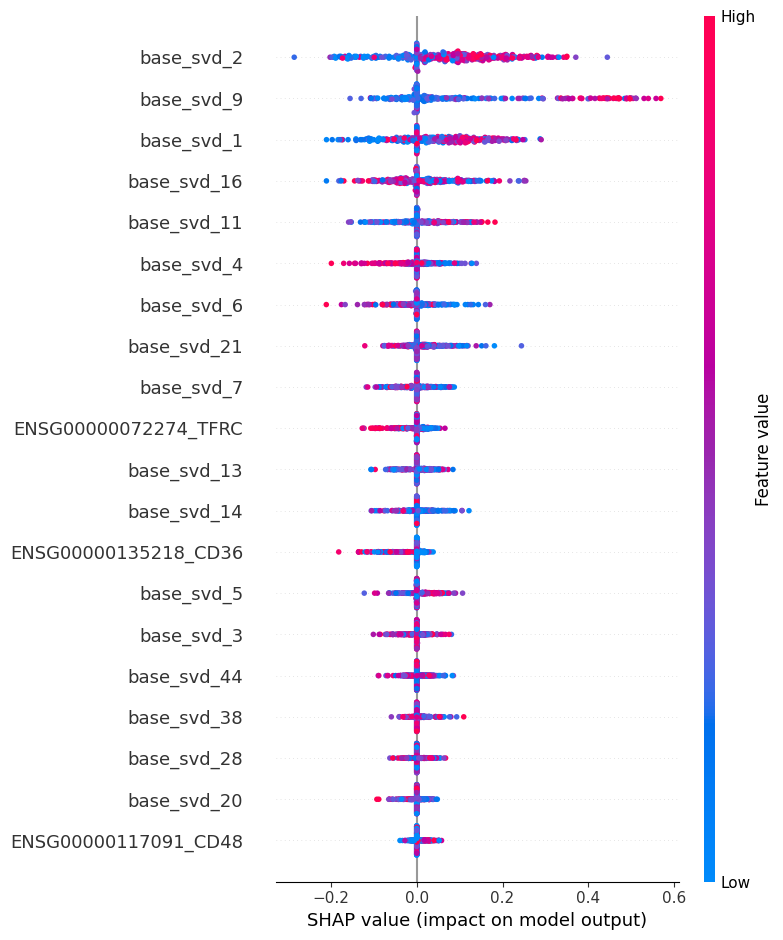

In [56]:
shap.initjs()
shap.summary_plot(shap_values[0], xtest.drop(['cell_id', 'cell_type'], axis=1), feature_names=xtest.drop(['cell_id', 'cell_type'], axis=1).columns)

# goal: get this plot as SHAP / features instead of SHAP / SVD components + features


Tight layout not applied. The bottom and top margins cannot be made large enough to accommodate all axes decorations.


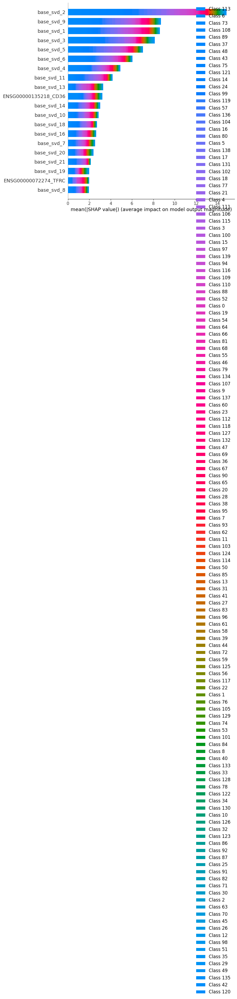

In [57]:
shap.initjs()
shap.summary_plot(list(shap_values), plot_type = 'bar', feature_names = xtest.drop(['cell_id', 'cell_type'], axis=1).columns)
# 140 classes = each regression output

### get colourful plot showing cell types

In [51]:
# print top 10 features plotted in beeswarm plot below
shap_sum = np.abs(shap_values[0]).sum(axis=0)
top_features_indices = np.argsort(shap_sum)[::-1][:10]  # Get the indices of the top 10 features
top_feature_names_shap = xtest.drop(['cell_id', 'cell_type'], axis=1).columns[top_features_indices]
top_feature_names_shap### plot shap values per cell type similar to shap.summary_plot(shap_values[0], xtest)

Index(['base_svd_2', 'base_svd_9', 'base_svd_1', 'base_svd_16', 'base_svd_11',
       'base_svd_4', 'base_svd_6', 'base_svd_21', 'base_svd_7',
       'ENSG00000072274_TFRC'],
      dtype='object')

In [99]:
# shap_values that are plotted in beeswarm below
# [0,:,2] == base_svd_2; [0,:,1] == base_svd_1 etc
second_element = shap_values[0, :, 9]
print(second_element[:20])
print(min(second_element))
max(second_element)

[ 0.02402991 -0.03167345  0.26256736 -0.09405039 -0.03421831  0.28434893
  0.23992858  0.35461594  0.02239423  0.25221524  0.12748891  0.05905342
  0.02510483  0.         -0.10785335  0.          0.39916961  0.
  0.04738398 -0.04140208]
-0.15537065745164913


0.5688849630827918

In [53]:
# print top 10 features plotted in beeswarm plot below
shap_sum = np.abs(shap_values[0]).sum(axis=0)
top_features_indices = np.argsort(shap_sum)[::-1][:10]  # Get the indices of the top 10 features
top_feature_names_shap = xtest.drop(['cell_id', 'cell_type'], axis=1).columns[top_features_indices]
top_feature_names_shap

Index(['base_svd_2', 'base_svd_9', 'base_svd_1', 'base_svd_16', 'base_svd_11',
       'base_svd_4', 'base_svd_6', 'base_svd_21', 'base_svd_7',
       'ENSG00000072274_TFRC'],
      dtype='object')

In [150]:
shap_cell_types = pd.DataFrame({'SHAP svd_2': shap_values[0, :, 2], 
                                'SHAP svd_9': shap_values[0, :, 9], 
                                'SHAP svd_1': shap_values[0, :, 1], 
                                'SHAP svd_16': shap_values[0, :, 16], 
                                'SHAP svd_11': shap_values[0, :, 11], 
                                'SHAP svd_4': shap_values[0, :, 4], 
                                'SHAP svd_6': shap_values[0, :, 6], 
                                'SHAP svd_21': shap_values[0, :, 21], 
                                'SHAP svd_7': shap_values[0, :, 7], 
                                'SHAP TFRC': shap_values[0, :, xtest.columns.get_loc('ENSG00000072274_TFRC')+1],  # TODO check +1
                                'Cell Type': xtest['cell_type']})
print(shap_cell_types.shape)
shap_cell_types.head()

(350, 11)


,SHAP svd_2,SHAP svd_9,SHAP svd_1,SHAP svd_16,SHAP svd_11,SHAP svd_4,SHAP svd_6,SHAP svd_21,SHAP svd_7,SHAP TFRC,Cell Type
0,0.152602,0.024030,0.015471,0.005517,-0.009934,0.078243,-0.013081,0.000000,0.054370,0.004221,BP
1,0.267562,-0.031673,-0.007481,0.037701,0.018402,0.045588,0.012253,0.100048,0.015193,0.000000,BP
2,-0.045403,0.262567,0.191901,0.000000,0.000000,-0.020373,0.000000,0.065520,0.023147,0.005754,BP
3,0.268057,-0.094050,0.019967,0.047309,0.000000,0.067233,0.000000,0.161228,-0.035381,0.000000,BP
4,0.203284,-0.034218,-0.015951,0.049831,-0.009138,0.000000,0.008481,-0.012390,0.034627,0.000000,BP


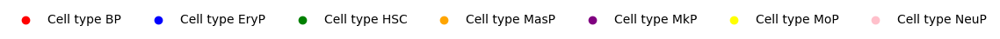

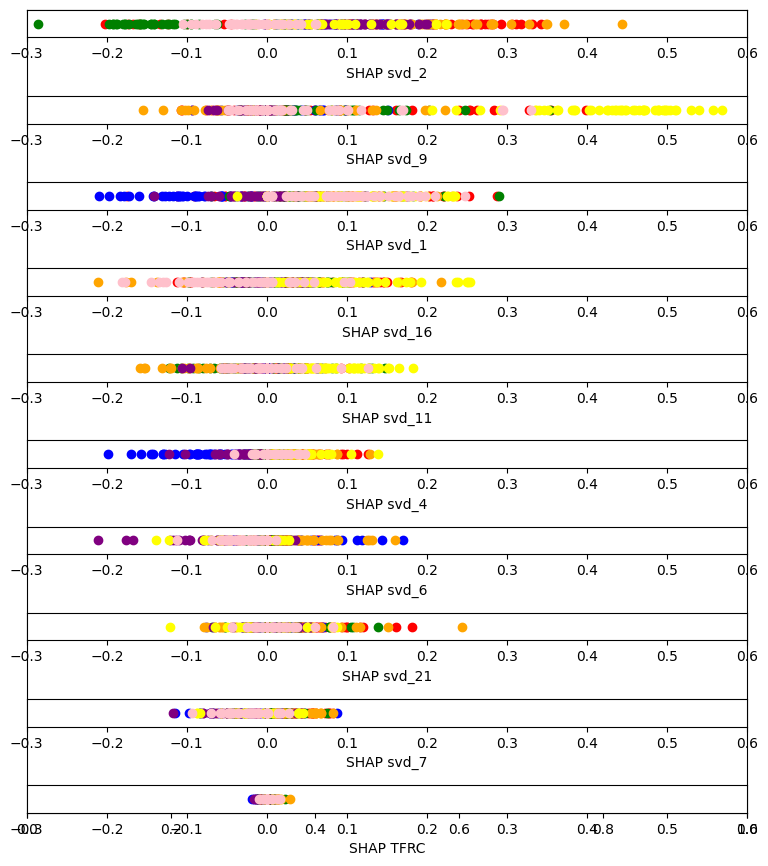

In [151]:
# Assign different colors to each class
colors = {'BP': 'red', 'EryP': 'blue', 'HSC': 'green', 'MasP': 'orange', 'MkP': 'purple', 'MoP': 'yellow', 'NeuP': 'pink'}

## legend ##
legend_fig, legend_ax = plt.subplots(figsize=(2, 2))

for class_label, color in colors.items():
    legend_ax.scatter([], [], color=color, label=f'Cell type {class_label}')

legend_ax.legend(loc='center', bbox_to_anchor=(0.5, 1.2), ncol=len(colors), frameon=False)
legend_ax.axis('off')
## legend ##


# plot shap values:
fig, ax = plt.subplots(figsize=(8, 10))

x_limit = (-0.3, 0.6)

# Remove y-axis ticks and labels
ax.yaxis.set_visible(False)

# Iterate over the columns in shap_cell_types to create subplots
for i, column in enumerate(shap_cell_types.columns[:-1], start=1):

    ax = fig.add_subplot(len(shap_cell_types.columns)-1, 1, i)

    # Set the x-axis limits and label
    ax.set_xlim(x_limit)
    ax.set_xlabel(column)

    ax.yaxis.set_visible(False)

    # Plot the dots for the current column
    for index, row in shap_cell_types.iterrows():
        shap_value = row[column]
        class_label = row['Cell Type']
        color = colors[class_label]
        ax.plot(shap_value, 0, marker='o', color=color)

        
fig.tight_layout(rect=[0, 0.1, 1, 1]) 
legend_fig.subplots_adjust(top=0.1, bottom=0.05)

plt.show()

### svd contributions:

In [58]:
svd_comp_norm = np.loadtxt('/dss/dsshome1/02/di93zoj/valentina/open-problems-multimodal-3rd-solution/code/2.preprocess_to_feature/cite/svd_comp_norm.txt', delimiter=',')
pd.DataFrame(svd_comp_norm)

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114,115,116,117,118,119,120,121,122,123,124,125,126,127,128,129,130,131,132,133,134,135,136,137,138,139,140,141,142,143,144,145,146,147,148,149,150,151,152,153,154,155,156,157,158,159,160,161,162,163,164,165,166,167,168,169,170,171,172,173,174,175,176,177,178,179,180,181,182,183,184,185,186,187,188,189,190,191,192,193,194,195,196,197,198,199,200,201,202,203,204,205,206,207,208,209,210,211,212,213,214,215,216,217,218,219,220,221,222,223,224,225,226,227,228,229,230,231,232,233,234,235,236,237,238,239,240,241,242,243,244,245,246,247,248,249,...,21751,21752,21753,21754,21755,21756,21757,21758,21759,21760,21761,21762,21763,21764,21765,21766,21767,21768,21769,21770,21771,21772,21773,21774,21775,21776,21777,21778,21779,21780,21781,21782,21783,21784,21785,21786,21787,21788,21789,21790,21791,21792,21793,21794,21795,21796,21797,21798,21799,21800,21801,21802,21803,21804,21805,21806,21807,21808,21809,21810,21811,21812,21813,21814,21815,21816,21817,21818,21819,21820,21821,21822,21823,21824,21825,21826,21827,21828,21829,21830,21831,21832,21833,21834,21835,21836,21837,21838,21839,21840,21841,21842,21843,21844,21845,21846,21847,21848,21849,21850,21851,21852,21853,21854,21855,21856,21857,21858,21859,21860,21861,21862,21863,21864,21865,21866,21867,21868,21869,21870,21871,21872,21873,21874,21875,21876,21877,21878,21879,21880,21881,21882,21883,21884,21885,21886,21887,21888,21889,21890,21891,21892,21893,21894,21895,21896,21897,21898,21899,21900,21901,21902,21903,21904,21905,21906,21907,21908,21909,21910,21911,21912,21913,21914,21915,21916,21917,21918,21919,21920,21921,21922,21923,21924,21925,21926,21927,21928,21929,21930,21931,21932,21933,21934,21935,21936,21937,21938,21939,21940,21941,21942,21943,21944,21945,21946,21947,21948,21949,21950,21951,21952,21953,21954,21955,21956,21957,21958,21959,21960,21961,21962,21963,21964,21965,21966,21967,21968,21969,21970,21971,21972,21973,21974,21975,21976,21977,21978,21979,21980,21981,21982,21983,21984,21985,21986,21987,21988,21989,21990,21991,21992,21993,21994,21995,21996,21997,21998,21999,22000
0,2.639231e-06,0.000006,8.334996e-07,5.828498e-06,2.757570e-08,3.741900e-06,0.000061,0.000067,0.000008,0.000045,0.000100,0.000086,0.000112,1.561256e-07,0.000032,1.728947e-06,0.000082,0.000014,0.000025,0.000051,0.000135,0.000007,5.866902e-07,0.000140,0.000002,1.095948e-06,6.541856e-06,0.000001,3.544955e-07,4.230418e-06,0.000003,1.019473e-06,0.000044,0.000005,0.000019,5.263685e-08,0.000017,0.000010,0.000057,7.720353e-07,7.685959e-07,5.282250e-07,0.000066,0.000036,0.000008,0.000052,0.000009,1.422967e-07,4.234706e-07,0.000006,0.000094,0.000042,8.176887e-07,5.854452e-06,0.000071,0.000045,0.000189,0.000212,0.000078,0.000032,0.000007,0.000003,1.333464e-06,0.000002,0.000066,0.000034,5.748485e-07,0.000048,7.900942e-07,3.164364e-05,0.000093,4.836841e-06,0.000124,1.730864e-05,4.585917e-08,0.000004,0.000133,1.834919e-06,0.000053,0.000023,0.000039,0.000086,0.000035,0.000010,0.000058,0.000009,0.000018,0.000091,0.000081,8.403822e-06,7.510666e-08,0.000025,0.000036,0.000047,2.525333e-08,0.000027,0.000026,0.000335,0.000075,0.000059,0.000094,0.000017,2.498941e-06,1.825300e-07,1.482199e-06,2.720675e-08,7.202646e-07,1.025972e-07,1.216199e-07,2.298947e-06,0.000005,4.184617e-08,3.321497e-07,7.704764e-07,6.641036e-08,5.345493e-07,1.273985e-08,3.954054e-07,2.966712e-07,7.642673e-07,9.612144e-08,1.299063e-06,1.313163e-07,0.000001,5.110732e-06,8.755644e-08,0.000015,2.911845e-06,3.102028e-07,3.421804e-08,3.980902e-06,3.033018e-07,0.000002,0.000116,0.000001,0.000010,0.000020,0.000005,1.464340e-07,1.359576e-06,6.118285e-07,7.770907e-07,2.120756e-06,2.090130e-06,0.000003,0.000020,6.725611e-06,0.000011,0.00000

In [59]:
# base_svd_2 important feature
svd_comp_norm[2]         # => contribution x_2 = -0.00001809 * geneA - 0.00000149 * geneB + 0.0000030917 * geneC + ... + 0.0001264 geneX + 0.00026577 geneY + 0.000175 geneZ

array([-1.80979350e-05, -1.49000311e-06,  3.09174447e-06, ...,
        1.26464845e-04,  2.65770446e-04,  1.75062174e-04])

In [60]:
pd.DataFrame(shap_values[0])

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114,115,116,117,118,119,120,121,122,123,124,125,126,127,128,129,130,131,132,133,134,135,136,137,138,139,140,141,142,143,144,145,146,147,148,149,150,151,152,153,154,155,156,157,158,159,160,161,162,163,164,165,166,167,168,169,170,171,172,173,174,175,176,177,178,179,180,181,182,183,184,185,186,187,188,189,190,191,192,193,194,195,196,197,198,199,200,201,202,203,204,205,206,207,208,209,210,211
0,0.000000,0.015471,0.152602,0.000000,0.078243,0.029166,-0.013081,0.054370,0.000000,0.024030,-0.021636,-0.009934,0.032557,0.000000,0.000000,0.000000,0.005517,0.006103,0.010306,0.000000,-0.042705,0.000000,-0.003572,-0.004732,0.000000,0.000000,0.000000,0.014586,0.006124,0.000000,0.000000,-0.016896,-0.007424,0.000000,0.010924,-0.009886,0.006340,0.014555,0.010130,0.021137,0.005499,-0.021536,0.000000,0.009422,0.010040,0.000000,0.008307,0.000000,0.000000,0.000000,0.000000,0.000000,0.009461,0.000000,0.000000,0.000000,0.003098,0.000000,0.003191,0.000000,0.000000,0.000000,0.017779,0.000000,-0.019075,0.011943,0.012577,-0.008402,-0.010510,0.000000,0.000000,0.003022,-0.000454,0.000000,-0.002870,0.000000,0.000000,0.000000,0.000000,-0.011354,0.000000,0.013391,0.000000,0.000000,0.000000,-0.014360,0.000000,-0.008252,-0.007308,0.000000,0.005348,0.001381,0.000000,0.000000,-0.001448,0.008054,-0.003224,0.001673,0.002412,-0.007350,0.000000,0.013512,-0.007312,0.000000,0.000000,0.000000,0.013512,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.006329,0.000000,-0.020179,0.000000,0.007387,0.000000,0.000000,-0.009582,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,-0.003235,-0.004834,0.000000,0.002459,0.000000,-0.001116,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,-0.006251,1.743964e-03,0.003759,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,-0.002720,0.000000,0.000000,-0.006506,0.000000,0.000000,0.000000,0.000000,0.002731,0.000236,0.000000,0.000000,0.017889,0.000000,0.000000,0.000000,0.000000,0.000000,-0.000153,0.019985,-0.003688,0.011178,0.000000,0.009132,-0.011177,0.000000,0.000000,0.000000,0.000000,0.000000,-0.006074,0.000000,0.000000,0.000000,0.000000,-0.009854,0.000000,0.000000,0.000000,0.000000,0.003438,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.004435,0.000000,0.000000,0.011336,0.000000,0.000000,0.000000,-0.001924,0.000000,0.003830,-0.002584,0.000000,0.015769,-0.060082,0.000000,0.004221,0.000000
1,0.000000,-0.007481,0.267562,0.000000,0.045588,0.010621,0.012253,0.015193,0.000000,-0.031673,-0.012506,0.018402,0.010618,0.012679,0.003336,0.009375,0.037701,0.000000,0.002827,0.000000,-0.015012,0.100048,0.000000,0.000000,0.000000,0.000000,0.000000,-0.006787,0.014187,0.000000,0.000000,-0.035403,0.000000,-0.006057,0.000000,0.000000,0.000000,0.000000,0.029208,0.000000,0.008146,-0.005724,0.000000,0.000000,0.000000,0.000000,0.000000,0.009619,-0.005241,-0.027132,0.000000,-0.003636,0.000000,0.020152,0.000000,-0.010001,0.000147,0.000000,0.000000,0.000000,0.000000,0.000000,-0.007919,0.001257,0.007996,-0.022181,0.000000,0.000000,0.000000,0.000000,0.019474,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,-0.004174,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.007349,0.004669,0.000000,0.000000,0.000000,0.000000,-0.006809,0.000000,0.000000,-0.013713,0.002297,-0.020674,0.000000,-0.001943,0.000000,-0.010986,-0.008130,0.000000,0.000000,0.000000,-0.015100,0.007171,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,-0.010594,0.007341,0.000000,0.000000,-0.007341,0.000000,0.000000,-0.003080,0.022765,0.000000,0.000000,0.000000,0.000000,0.005663,0.000000,-0.009775,0.000000,0.000000,-0.012223,0.000000e+00,0.0000

### propagate shap values back through svd to get original genes -> store in attr_all_22085_genes
#### currently only first class (shap_values[0]) -> TODO consider all 140 classes

In [61]:
# multiply SHAP(svd_n)*contribution of gene A to component n -> sum
# each dot in summary_plot is attribution for one cell -> loop over all cells

# 212 features: 128 svd and 84 genes
# cells: 350
# predicted "classes": 140

# contribution of gene A to component n: svd_comp_norm
# SHAP(svd_n) for the 128 svd (=first 128 columns)


# TODO delete below, should be represented in next cell
# attr_genes_only = np.zeros((len(xtest), 22001))  # Initialize the output array, 350x22001

# for cell in range(len(xtest)):
#     for gene in range(22001):
#         attr_gene = 0
#         for svd in range(128):
#             attr_gene += shap_values[0][cell][svd] * svd_comp_norm[svd][gene]   # this is for one cell -> loop over all cells
#         attr_genes_only[cell][gene] = attr_gene
# attr_genes_only

In [62]:
# add third dimension -> 140x350x22001
attr_genes_only = np.zeros((shap_values.shape[0], len(xtest), 22001))  # Initialize the output array, 140x350x22001

for pred in range(shap_values.shape[0]):
    for cell in range(len(xtest)):
        attr_genes_only[pred, cell] = np.sum(shap_values[pred, cell, :128, None] * svd_comp_norm[:128], axis=0)

attr_genes_only

array([[[-8.98243626e-05, -1.26776801e-04,  4.77819597e-04, ...,
         -3.66480768e-04,  2.12195223e-03,  9.34887807e-06],
        [ 7.81398694e-05, -3.18499096e-04, -8.17383437e-04, ...,
          2.98340058e-03,  1.86576801e-02,  3.62939792e-04],
        [-1.57419820e-04, -3.18080074e-04,  1.58834246e-03, ...,
         -1.23255906e-03,  5.08655494e-03,  1.27173386e-03],
        ...,
        [ 4.48975940e-05, -6.11372847e-05,  1.17753077e-04, ...,
          1.49803459e-04,  1.09311594e-03,  1.38368275e-04],
        [ 3.87039653e-05, -5.34953947e-05, -1.21764107e-04, ...,
          2.96202285e-04,  6.36706483e-03,  2.92429593e-04],
        [ 9.60431751e-05,  2.38966328e-05, -4.91429510e-05, ...,
          3.40839759e-04,  2.90185005e-04,  2.95310867e-04]],

       [[-9.00750720e-05, -5.26465613e-05,  5.69579205e-04, ...,
         -3.90560090e-04,  3.87070140e-03, -2.88069614e-04],
        [-1.59707736e-05, -6.53002813e-05, -1.35774125e-04, ...,
          3.55539902e-04,  2.35265322e

In [63]:
attr_genes_only[0]

array([[-8.98243626e-05, -1.26776801e-04,  4.77819597e-04, ...,
        -3.66480768e-04,  2.12195223e-03,  9.34887807e-06],
       [ 7.81398694e-05, -3.18499096e-04, -8.17383437e-04, ...,
         2.98340058e-03,  1.86576801e-02,  3.62939792e-04],
       [-1.57419820e-04, -3.18080074e-04,  1.58834246e-03, ...,
        -1.23255906e-03,  5.08655494e-03,  1.27173386e-03],
       ...,
       [ 4.48975940e-05, -6.11372847e-05,  1.17753077e-04, ...,
         1.49803459e-04,  1.09311594e-03,  1.38368275e-04],
       [ 3.87039653e-05, -5.34953947e-05, -1.21764107e-04, ...,
         2.96202285e-04,  6.36706483e-03,  2.92429593e-04],
       [ 9.60431751e-05,  2.38966328e-05, -4.91429510e-05, ...,
         3.40839759e-04,  2.90185005e-04,  2.95310867e-04]])

In [64]:
all_genes = np.loadtxt('/dss/dsshome1/02/di93zoj/valentina/open-problems-multimodal-3rd-solution/code/2.preprocess_to_feature/cite/all_genes_names.txt', dtype=str)
all_genes   # len 22001   (excl. the 84 other genes)   -> need list(all_genes) + gene_ids

array(['ENSG00000121410_A1BG', 'ENSG00000268895_A1BG-AS1',
       'ENSG00000175899_A2M', ..., 'ENSG00000162378_ZYG11B',
       'ENSG00000159840_ZYX', 'ENSG00000074755_ZZEF1'], dtype='<U41')

In [101]:
attr_all_22085_genes = np.hstack((attr_genes_only[0], shap_values[0][:,-84:]))    # first 22001 genes are backpropagated through svd, the other 84 genes are handselected and are considered separately
print(pd.DataFrame(attr_all_22085_genes, columns=list(all_genes)+gene_ids).shape)
pd.DataFrame(attr_all_22085_genes, columns=list(all_genes)+gene_ids).head()

(350, 22085)


,ENSG00000121410_A1BG,ENSG00000268895_A1BG-AS1,ENSG00000175899_A2M,ENSG00000245105_A2M-AS1,ENSG00000166535_A2ML1,ENSG00000128274_A4GALT,ENSG00000094914_AAAS,ENSG00000081760_AACS,ENSG00000109576_AADAT,ENSG00000103591_AAGAB,ENSG00000115977_AAK1,ENSG00000087884_AAMDC,ENSG00000127837_AAMP,ENSG00000129673_AANAT,ENSG00000131043_AAR2,ENSG00000205002_AARD,ENSG00000090861_AARS,ENSG00000124608_AARS2,ENSG00000266967_AARSD1,ENSG00000157426_AASDH,ENSG00000149313_AASDHPPT,ENSG00000008311_AASS,ENSG00000215458_AATBC,ENSG00000275700_AATF,ENSG00000181409_AATK,ENSG00000281376_ABALON,ENSG00000183044_ABAT,ENSG00000165029_ABCA1,ENSG00000154263_ABCA10,ENSG00000251595_ABCA11P,ENSG00000179869_ABCA13,ENSG00000238098_ABCA17P,ENSG00000107331_ABCA2,ENSG00000167972_ABCA3,ENSG00000154265_ABCA5,ENSG00000154262_ABCA6,ENSG00000064687_ABCA7,ENSG00000085563_ABCB1,ENSG00000135776_ABCB10,ENSG00000073734_ABCB11,ENSG00000005471_ABCB4,ENSG00000115657_ABCB6,ENSG00000131269_ABCB7,ENSG00000197150_ABCB8,ENSG00000150967_ABCB9,ENSG00000103222_ABCC1,ENSG00000124574_ABCC10,ENSG00000243064_ABCC13,ENSG00000023839_ABCC2,ENSG00000108846_ABCC3,ENSG00000125257_ABCC4,ENSG00000114770_ABCC5,ENSG00000091262_ABCC6,ENSG00000101986_ABCD1,ENSG00000117528_ABCD3,ENSG00000119688_ABCD4,ENSG00000164163_ABCE1,ENSG00000204574_ABCF1,ENSG00000033050_ABCF2,ENSG00000161204_ABCF3,ENSG00000160179_ABCG1,ENSG00000118777_ABCG2,ENSG00000143921_ABCG8,ENSG00000143994_ABHD1,ENSG00000144827_ABHD10,ENSG00000106077_ABHD11,ENSG00000225969_ABHD11-AS1,ENSG00000100997_ABHD12,ENSG00000131969_ABHD12B,ENSG00000139826_ABHD13,ENSG00000248487_ABHD14A,ENSG00000114786_ABHD14A-ACY1,ENSG00000114779_ABHD14B,ENSG00000168792_ABHD15,ENSG00000264031_ABHD15-AS1,ENSG00000204427_ABHD16A,ENSG00000129968_ABHD17A,ENSG00000250536_ABHD17AP3,ENSG00000107362_ABHD17B,ENSG00000136379_ABHD17C,ENSG00000164074_ABHD18,ENSG00000140526_ABHD2,ENSG00000158201_ABHD3,ENSG00000100439_ABHD4,ENSG00000011198_ABHD5,ENSG00000163686_ABHD6,ENSG00000127220_ABHD8,ENSG00000136754_ABI1,ENSG00000138443_ABI2,ENSG00000108798_ABI3,ENSG00000154175_ABI3BP,ENSG00000097007_ABL1,ENSG00000143322_ABL2,ENSG00000099204_ABLIM1,ENSG00000173210_ABLIM3,ENSG00000175164_ABO,ENSG00000159842_ABR,ENSG00000146386_ABRACL,ENSG00000163322_ABRAXAS1,ENSG00000165660_ABRAXAS2,ENSG00000146109_ABT1,ENSG00000114626_ABTB1,ENSG00000166016_ABTB2,ENSG00000260246_AC000032.1,ENSG00000185065_AC000068.1,ENSG00000273212_AC000068.2,ENSG00000273300_AC000068.3,ENSG00000235776_AC000089.1,ENSG00000243107_AC000120.1,ENSG00000279265_AC000123.2,ENSG00000280347_AC000123.3,ENSG00000278727_AC000403.1,ENSG00000274898_AC001226.1,ENSG00000283208_AC001226.2,ENSG00000272330_AC002044.1,ENSG00000279591_AC002044.2,ENSG00000213683_AC002056.1,ENSG00000273216_AC002059.1,ENSG00000248636_AC002070.1,ENSG00000237729_AC002075.2,ENSG00000265975_AC002091.1,ENSG00000266389_AC002091.2,ENSG00000265618_AC002094.2,ENSG00000277450_AC002094.4,ENSG00000267698_AC002116.2,ENSG00000268947_AC002128.1,ENSG00000235560_AC002310.1,ENSG00000239791_AC002310.2,ENSG00000278922_AC002310.6,ENSG00000261433_AC002347.1,ENSG00000278993_AC002350.1,ENSG00000232392_AC002366.1,ENSG00000283638_AC002407.1,ENSG00000237819_AC002454.1,ENSG00000223969_AC002456.1,ENSG00000260188_AC002464.1,ENSG00000241764_AC002467.1,ENSG00000272829_AC002470.1,ENSG00000284060_AC002472.2,ENSG00000235945_AC002543.1,ENSG00000261312_AC002550.1,ENSG00000276571_AC002550.2,ENSG00000227782_AC002553.1,ENSG00000275413_AC002553.2,ENSG00000239291_AC002558.1,ENSG00000262265_AC002558.3,ENSG00000260793_AC003102.1,ENSG00000279159_AC003681.1,ENSG00000263280_AC003965.1,ENSG00000279377_AC003973.3,ENSG00000228113_AC003991.1,ENSG00000254003_AC003991.2,ENSG00000237903_AC004000.1,ENSG00000262482_AC004034.1,ENSG00000196656_AC004057.1,ENSG00000273447_AC004067.1,ENSG00000251259_AC004069.1,ENSG00000276449_AC004076.2,ENSG00000270182_AC004080.4,ENSG00000271133_AC004130.1,ENSG00000263272_AC004148.2,ENSG00000267666_AC004156.1,ENSG00000260664_AC004158.1,ENSG00000267457_AC004223.2,ENSG00000273687_AC004223.3,ENSG0000026

In [66]:
# organize indices, use same sample cells as above
test_inputs = scipy.sparse.load_npz(index_path + "test_cite_raw_inputs_values.sparse.npz")
test_inputs = pd.DataFrame(test_inputs.toarray(), columns=list(all_genes)+gene_ids)

# get cell ids
test_ids = np.load(index_path + "test_cite_raw_inputs_idxcol.npz", allow_pickle=True)
test_index = test_ids["index"]
len(test_index)

test_inputs.index = test_index

test_inputs

,ENSG00000121410_A1BG,ENSG00000268895_A1BG-AS1,ENSG00000175899_A2M,ENSG00000245105_A2M-AS1,ENSG00000166535_A2ML1,ENSG00000128274_A4GALT,ENSG00000094914_AAAS,ENSG00000081760_AACS,ENSG00000109576_AADAT,ENSG00000103591_AAGAB,ENSG00000115977_AAK1,ENSG00000087884_AAMDC,ENSG00000127837_AAMP,ENSG00000129673_AANAT,ENSG00000131043_AAR2,ENSG00000205002_AARD,ENSG00000090861_AARS,ENSG00000124608_AARS2,ENSG00000266967_AARSD1,ENSG00000157426_AASDH,ENSG00000149313_AASDHPPT,ENSG00000008311_AASS,ENSG00000215458_AATBC,ENSG00000275700_AATF,ENSG00000181409_AATK,ENSG00000281376_ABALON,ENSG00000183044_ABAT,ENSG00000165029_ABCA1,ENSG00000154263_ABCA10,ENSG00000251595_ABCA11P,ENSG00000179869_ABCA13,ENSG00000238098_ABCA17P,ENSG00000107331_ABCA2,ENSG00000167972_ABCA3,ENSG00000154265_ABCA5,ENSG00000154262_ABCA6,ENSG00000064687_ABCA7,ENSG00000085563_ABCB1,ENSG00000135776_ABCB10,ENSG00000073734_ABCB11,ENSG00000005471_ABCB4,ENSG00000115657_ABCB6,ENSG00000131269_ABCB7,ENSG00000197150_ABCB8,ENSG00000150967_ABCB9,ENSG00000103222_ABCC1,ENSG00000124574_ABCC10,ENSG00000243064_ABCC13,ENSG00000023839_ABCC2,ENSG00000108846_ABCC3,ENSG00000125257_ABCC4,ENSG00000114770_ABCC5,ENSG00000091262_ABCC6,ENSG00000101986_ABCD1,ENSG00000117528_ABCD3,ENSG00000119688_ABCD4,ENSG00000164163_ABCE1,ENSG00000204574_ABCF1,ENSG00000033050_ABCF2,ENSG00000161204_ABCF3,ENSG00000160179_ABCG1,ENSG00000118777_ABCG2,ENSG00000143921_ABCG8,ENSG00000143994_ABHD1,ENSG00000144827_ABHD10,ENSG00000106077_ABHD11,ENSG00000225969_ABHD11-AS1,ENSG00000100997_ABHD12,ENSG00000131969_ABHD12B,ENSG00000139826_ABHD13,ENSG00000248487_ABHD14A,ENSG00000114786_ABHD14A-ACY1,ENSG00000114779_ABHD14B,ENSG00000168792_ABHD15,ENSG00000264031_ABHD15-AS1,ENSG00000204427_ABHD16A,ENSG00000129968_ABHD17A,ENSG00000250536_ABHD17AP3,ENSG00000107362_ABHD17B,ENSG00000136379_ABHD17C,ENSG00000164074_ABHD18,ENSG00000140526_ABHD2,ENSG00000158201_ABHD3,ENSG00000100439_ABHD4,ENSG00000011198_ABHD5,ENSG00000163686_ABHD6,ENSG00000127220_ABHD8,ENSG00000136754_ABI1,ENSG00000138443_ABI2,ENSG00000108798_ABI3,ENSG00000154175_ABI3BP,ENSG00000097007_ABL1,ENSG00000143322_ABL2,ENSG00000099204_ABLIM1,ENSG00000173210_ABLIM3,ENSG00000175164_ABO,ENSG00000159842_ABR,ENSG00000146386_ABRACL,ENSG00000163322_ABRAXAS1,ENSG00000165660_ABRAXAS2,ENSG00000146109_ABT1,ENSG00000114626_ABTB1,ENSG00000166016_ABTB2,ENSG00000260246_AC000032.1,ENSG00000185065_AC000068.1,ENSG00000273212_AC000068.2,ENSG00000273300_AC000068.3,ENSG00000235776_AC000089.1,ENSG00000243107_AC000120.1,ENSG00000279265_AC000123.2,ENSG00000280347_AC000123.3,ENSG00000278727_AC000403.1,ENSG00000274898_AC001226.1,ENSG00000283208_AC001226.2,ENSG00000272330_AC002044.1,ENSG00000279591_AC002044.2,ENSG00000213683_AC002056.1,ENSG00000273216_AC002059.1,ENSG00000248636_AC002070.1,ENSG00000237729_AC002075.2,ENSG00000265975_AC002091.1,ENSG00000266389_AC002091.2,ENSG00000265618_AC002094.2,ENSG00000277450_AC002094.4,ENSG00000267698_AC002116.2,ENSG00000268947_AC002128.1,ENSG00000235560_AC002310.1,ENSG00000239791_AC002310.2,ENSG00000278922_AC002310.6,ENSG00000261433_AC002347.1,ENSG00000278993_AC002350.1,ENSG00000232392_AC002366.1,ENSG00000283638_AC002407.1,ENSG00000237819_AC002454.1,ENSG00000223969_AC002456.1,ENSG00000260188_AC002464.1,ENSG00000241764_AC002467.1,ENSG00000272829_AC002470.1,ENSG00000284060_AC002472.2,ENSG00000235945_AC002543.1,ENSG00000261312_AC002550.1,ENSG00000276571_AC002550.2,ENSG00000227782_AC002553.1,ENSG00000275413_AC002553.2,ENSG00000239291_AC002558.1,ENSG00000262265_AC002558.3,ENSG00000260793_AC003102.1,ENSG00000279159_AC003681.1,ENSG00000263280_AC003965.1,ENSG00000279377_AC003973.3,ENSG00000228113_AC003991.1,ENSG00000254003_AC003991.2,ENSG00000237903_AC004000.1,ENSG00000262482_AC004034.1,ENSG00000196656_AC004057.1,ENSG00000273447_AC004067.1,ENSG00000251259_AC004069.1,ENSG00000276449_AC004076.2,ENSG00000270182_AC004080.4,ENSG00000271133_AC004130.1,ENSG00000263272_AC004148.2,ENSG00000267666_AC004156.1,ENSG00000260664_AC004158.1,ENSG00000267457_AC004223.2,ENSG00000273687_AC004223.3,ENSG0000026

In [81]:
# cell ids used in xtest and SHAP:
sample_cells = np.array(xtest['cell_id'])
sample_cells[:20]

array(['90a09b6b576b', '576b8516f44d', '2d58c9db6a10', 'f507be21e97c',
       '46a536d2aba8', 'f7f1eea460b7', '1d17a26b762b', '9fcb51a69875',
       '8188329ae647', '7504e1c3c1b2', '83ef3822c5ed', '086fe7d5e9a8',
       '23acde7482e4', '926cf0380476', '03fd2f45ee88', '7798cfe1a4a7',
       'f159535b51cc', '5019edd1990d', 'd443b74b8869', 'd98beb1e2c53'],
      dtype=object)

In [82]:
xtest_all_genes = test_inputs.loc[sample_cells]
print(xtest_all_genes.shape)
xtest_all_genes.head()

(350, 22085)


,ENSG00000121410_A1BG,ENSG00000268895_A1BG-AS1,ENSG00000175899_A2M,ENSG00000245105_A2M-AS1,ENSG00000166535_A2ML1,ENSG00000128274_A4GALT,ENSG00000094914_AAAS,ENSG00000081760_AACS,ENSG00000109576_AADAT,ENSG00000103591_AAGAB,ENSG00000115977_AAK1,ENSG00000087884_AAMDC,ENSG00000127837_AAMP,ENSG00000129673_AANAT,ENSG00000131043_AAR2,ENSG00000205002_AARD,ENSG00000090861_AARS,ENSG00000124608_AARS2,ENSG00000266967_AARSD1,ENSG00000157426_AASDH,ENSG00000149313_AASDHPPT,ENSG00000008311_AASS,ENSG00000215458_AATBC,ENSG00000275700_AATF,ENSG00000181409_AATK,ENSG00000281376_ABALON,ENSG00000183044_ABAT,ENSG00000165029_ABCA1,ENSG00000154263_ABCA10,ENSG00000251595_ABCA11P,ENSG00000179869_ABCA13,ENSG00000238098_ABCA17P,ENSG00000107331_ABCA2,ENSG00000167972_ABCA3,ENSG00000154265_ABCA5,ENSG00000154262_ABCA6,ENSG00000064687_ABCA7,ENSG00000085563_ABCB1,ENSG00000135776_ABCB10,ENSG00000073734_ABCB11,ENSG00000005471_ABCB4,ENSG00000115657_ABCB6,ENSG00000131269_ABCB7,ENSG00000197150_ABCB8,ENSG00000150967_ABCB9,ENSG00000103222_ABCC1,ENSG00000124574_ABCC10,ENSG00000243064_ABCC13,ENSG00000023839_ABCC2,ENSG00000108846_ABCC3,ENSG00000125257_ABCC4,ENSG00000114770_ABCC5,ENSG00000091262_ABCC6,ENSG00000101986_ABCD1,ENSG00000117528_ABCD3,ENSG00000119688_ABCD4,ENSG00000164163_ABCE1,ENSG00000204574_ABCF1,ENSG00000033050_ABCF2,ENSG00000161204_ABCF3,ENSG00000160179_ABCG1,ENSG00000118777_ABCG2,ENSG00000143921_ABCG8,ENSG00000143994_ABHD1,ENSG00000144827_ABHD10,ENSG00000106077_ABHD11,ENSG00000225969_ABHD11-AS1,ENSG00000100997_ABHD12,ENSG00000131969_ABHD12B,ENSG00000139826_ABHD13,ENSG00000248487_ABHD14A,ENSG00000114786_ABHD14A-ACY1,ENSG00000114779_ABHD14B,ENSG00000168792_ABHD15,ENSG00000264031_ABHD15-AS1,ENSG00000204427_ABHD16A,ENSG00000129968_ABHD17A,ENSG00000250536_ABHD17AP3,ENSG00000107362_ABHD17B,ENSG00000136379_ABHD17C,ENSG00000164074_ABHD18,ENSG00000140526_ABHD2,ENSG00000158201_ABHD3,ENSG00000100439_ABHD4,ENSG00000011198_ABHD5,ENSG00000163686_ABHD6,ENSG00000127220_ABHD8,ENSG00000136754_ABI1,ENSG00000138443_ABI2,ENSG00000108798_ABI3,ENSG00000154175_ABI3BP,ENSG00000097007_ABL1,ENSG00000143322_ABL2,ENSG00000099204_ABLIM1,ENSG00000173210_ABLIM3,ENSG00000175164_ABO,ENSG00000159842_ABR,ENSG00000146386_ABRACL,ENSG00000163322_ABRAXAS1,ENSG00000165660_ABRAXAS2,ENSG00000146109_ABT1,ENSG00000114626_ABTB1,ENSG00000166016_ABTB2,ENSG00000260246_AC000032.1,ENSG00000185065_AC000068.1,ENSG00000273212_AC000068.2,ENSG00000273300_AC000068.3,ENSG00000235776_AC000089.1,ENSG00000243107_AC000120.1,ENSG00000279265_AC000123.2,ENSG00000280347_AC000123.3,ENSG00000278727_AC000403.1,ENSG00000274898_AC001226.1,ENSG00000283208_AC001226.2,ENSG00000272330_AC002044.1,ENSG00000279591_AC002044.2,ENSG00000213683_AC002056.1,ENSG00000273216_AC002059.1,ENSG00000248636_AC002070.1,ENSG00000237729_AC002075.2,ENSG00000265975_AC002091.1,ENSG00000266389_AC002091.2,ENSG00000265618_AC002094.2,ENSG00000277450_AC002094.4,ENSG00000267698_AC002116.2,ENSG00000268947_AC002128.1,ENSG00000235560_AC002310.1,ENSG00000239791_AC002310.2,ENSG00000278922_AC002310.6,ENSG00000261433_AC002347.1,ENSG00000278993_AC002350.1,ENSG00000232392_AC002366.1,ENSG00000283638_AC002407.1,ENSG00000237819_AC002454.1,ENSG00000223969_AC002456.1,ENSG00000260188_AC002464.1,ENSG00000241764_AC002467.1,ENSG00000272829_AC002470.1,ENSG00000284060_AC002472.2,ENSG00000235945_AC002543.1,ENSG00000261312_AC002550.1,ENSG00000276571_AC002550.2,ENSG00000227782_AC002553.1,ENSG00000275413_AC002553.2,ENSG00000239291_AC002558.1,ENSG00000262265_AC002558.3,ENSG00000260793_AC003102.1,ENSG00000279159_AC003681.1,ENSG00000263280_AC003965.1,ENSG00000279377_AC003973.3,ENSG00000228113_AC003991.1,ENSG00000254003_AC003991.2,ENSG00000237903_AC004000.1,ENSG00000262482_AC004034.1,ENSG00000196656_AC004057.1,ENSG00000273447_AC004067.1,ENSG00000251259_AC004069.1,ENSG00000276449_AC004076.2,ENSG00000270182_AC004080.4,ENSG00000271133_AC004130.1,ENSG00000263272_AC004148.2,ENSG00000267666_AC004156.1,ENSG00000260664_AC004158.1,ENSG00000267457_AC004223.2,ENSG00000273687_AC004223.3,ENSG0000026

No data for colormapping provided via 'c'. Parameters 'vmin', 'vmax' will be ignored


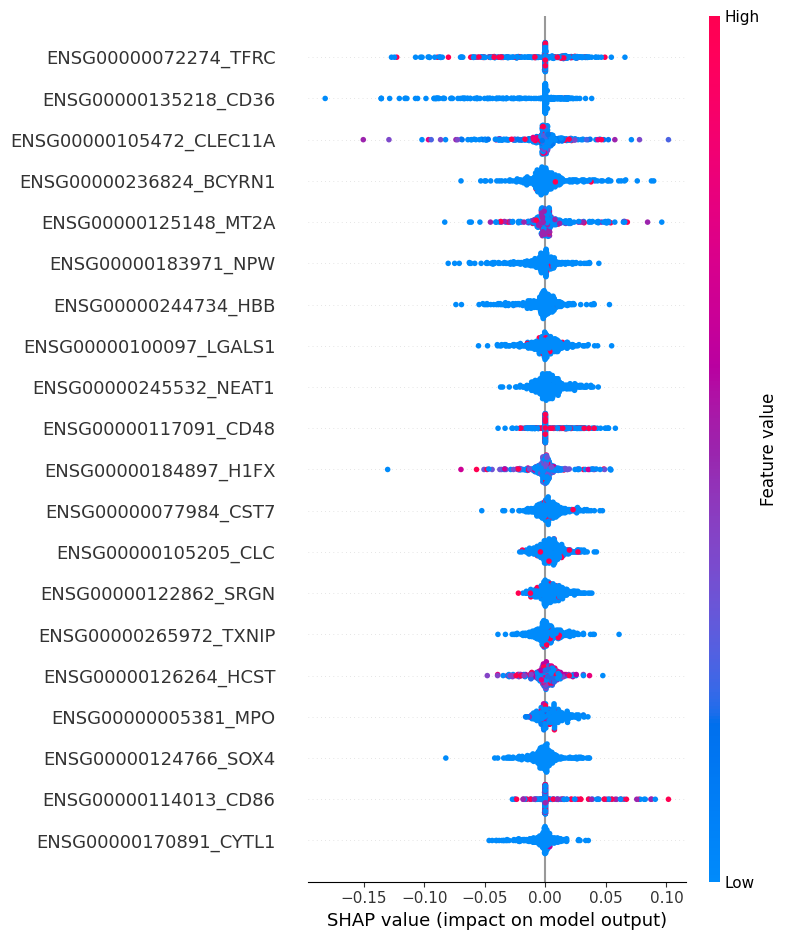

In [69]:
shap.initjs()
shap.summary_plot(attr_all_22085_genes, xtest_all_genes, feature_names=xtest_all_genes.columns)

### get colourful plot showing cell types

In [103]:
# print top 10 features plotted in beeswarm plot below
attr_sum = np.abs(attr_all_22085_genes).sum(axis=0)
top_features_indices = np.argsort(attr_sum)[::-1][:10]  # Get the indices of the top 10 features
top_feature_names_shap = xtest_all_genes.columns[top_features_indices]
top_feature_names_shap### plot shap values per cell type similar to shap.summary_plot(shap_values[0], xtest)

Index(['ENSG00000072274_TFRC', 'ENSG00000135218_CD36',
       'ENSG00000105472_CLEC11A', 'ENSG00000236824_BCYRN1',
       'ENSG00000125148_MT2A', 'ENSG00000183971_NPW', 'ENSG00000244734_HBB',
       'ENSG00000100097_LGALS1', 'ENSG00000245532_NEAT1',
       'ENSG00000117091_CD48'],
      dtype='object')

In [114]:
# sanity check for attribution of TFRC -> compare min/max to shap beeswarm plotted above
tfrc_attr = attr_all_22085_genes[:, xtest_all_genes.columns.get_loc('ENSG00000072274_TFRC')]
print(tfrc_attr[:20])
print(min(tfrc_attr))
max(tfrc_attr)

[-0.06008248 -0.00828236  0.02140234  0.         -0.04274079  0.
  0.01490482  0.         -0.08920017  0.03321763  0.          0.03254935
 -0.03217935 -0.02656521 -0.03179443 -0.01224451 -0.0233455   0.01653901
 -0.06914572 -0.05752194]
-0.12703818537476635


0.06575961050846373

In [120]:
dict_top_10 = {}
for gene in top_feature_names_shap:
    dict_top_10[gene] = attr_all_22085_genes[:, xtest_all_genes.columns.get_loc(gene)]
dict_top_10['Cell Type'] = xtest['cell_type']
shap_cell_types = pd.DataFrame(dict_top_10)
print(shap_cell_types.shape)
shap_cell_types.head()

(350, 11)


,ENSG00000072274_TFRC,ENSG00000135218_CD36,ENSG00000105472_CLEC11A,ENSG00000236824_BCYRN1,ENSG00000125148_MT2A,ENSG00000183971_NPW,ENSG00000244734_HBB,ENSG00000100097_LGALS1,ENSG00000245532_NEAT1,ENSG00000117091_CD48,Cell Type
0,-0.060082,-0.002720,-0.032105,0.008818,0.019902,-0.016152,-0.014856,-0.004746,0.005782,0.000000,BP
1,-0.008282,0.005653,0.046390,-0.024518,-0.028962,0.029342,0.017276,0.000150,-0.035250,-0.013962,BP
2,0.021402,0.006135,-0.094261,0.060605,0.064790,-0.062481,-0.050461,-0.026205,0.024123,0.000000,BP
3,0.000000,-0.000235,-0.002564,0.000996,0.003097,-0.008686,-0.004595,0.005661,-0.009688,0.013605,BP
4,-0.042741,0.005635,-0.008530,0.000465,-0.000148,0.005410,-0.002195,0.000343,-0.004533,-0.012483,BP


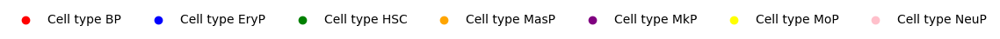

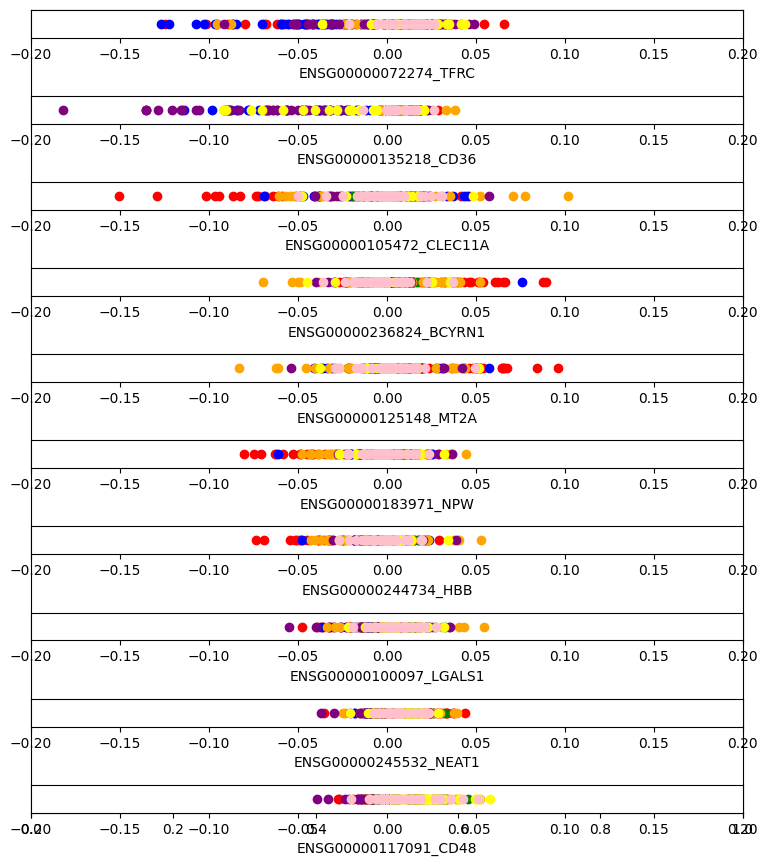

In [125]:
# Assign different colors to each class
colors = {'BP': 'red', 'EryP': 'blue', 'HSC': 'green', 'MasP': 'orange', 'MkP': 'purple', 'MoP': 'yellow', 'NeuP': 'pink'}

## legend ##
legend_fig, legend_ax = plt.subplots(figsize=(2, 2))

for class_label, color in colors.items():
    legend_ax.scatter([], [], color=color, label=f'Cell type {class_label}')

legend_ax.legend(loc='center', bbox_to_anchor=(0.5, 1.2), ncol=len(colors), frameon=False)
legend_ax.axis('off')
## legend ##


# plot shap values:
fig, ax = plt.subplots(figsize=(8, 10))

x_limit = (-0.2, 0.2)

# Remove y-axis ticks and labels
ax.yaxis.set_visible(False)

# Iterate over the columns in shap_cell_types to create subplots
for i, column in enumerate(shap_cell_types.columns[:-1], start=1):

    ax = fig.add_subplot(len(shap_cell_types.columns)-1, 1, i)

    # Set the x-axis limits and label
    ax.set_xlim(x_limit)
    ax.set_xlabel(column)

    ax.yaxis.set_visible(False)

    # Plot the dots for the current column
    for index, row in shap_cell_types.iterrows():
        shap_value = row[column]
        class_label = row['Cell Type']
        color = colors[class_label]
        ax.plot(shap_value, 0, marker='o', color=color)    # , markersize=2)

        
fig.tight_layout(rect=[0, 0.1, 1, 1]) 
legend_fig.subplots_adjust(top=0.1, bottom=0.05)

plt.show()

In [140]:
# top 20 genes:
shap_sum = np.abs(attr_all_22085_genes).sum(axis=0)
top_features_indices = np.argsort(shap_sum)[::-1][:20]  # Get the indices of the top 20 features
top_20_feature_names_shap = xtest_all_genes.columns[top_features_indices]
top_20_feature_names_shap

Index(['ENSG00000072274_TFRC', 'ENSG00000135218_CD36',
       'ENSG00000105472_CLEC11A', 'ENSG00000236824_BCYRN1',
       'ENSG00000125148_MT2A', 'ENSG00000183971_NPW', 'ENSG00000244734_HBB',
       'ENSG00000100097_LGALS1', 'ENSG00000245532_NEAT1',
       'ENSG00000117091_CD48', 'ENSG00000184897_H1FX', 'ENSG00000077984_CST7',
       'ENSG00000105205_CLC', 'ENSG00000122862_SRGN', 'ENSG00000265972_TXNIP',
       'ENSG00000126264_HCST', 'ENSG00000005381_MPO', 'ENSG00000124766_SOX4',
       'ENSG00000114013_CD86', 'ENSG00000170891_CYTL1'],
      dtype='object')

In [131]:
for gene in top_20_feature_names_shap:
    if gene in list(all_genes):
        print(gene, 'among 22001 genes.')
    if gene in gene_ids:
        print(gene, 'among handselected 84 genes.')

ENSG00000072274_TFRC among handselected 84 genes.
ENSG00000135218_CD36 among handselected 84 genes.
ENSG00000105472_CLEC11A among 22001 genes.
ENSG00000236824_BCYRN1 among 22001 genes.
ENSG00000125148_MT2A among 22001 genes.
ENSG00000183971_NPW among 22001 genes.
ENSG00000244734_HBB among 22001 genes.
ENSG00000100097_LGALS1 among 22001 genes.
ENSG00000245532_NEAT1 among 22001 genes.
ENSG00000117091_CD48 among handselected 84 genes.
ENSG00000184897_H1FX among 22001 genes.
ENSG00000077984_CST7 among 22001 genes.
ENSG00000105205_CLC among 22001 genes.
ENSG00000122862_SRGN among 22001 genes.
ENSG00000265972_TXNIP among 22001 genes.
ENSG00000126264_HCST among 22001 genes.
ENSG00000005381_MPO among 22001 genes.
ENSG00000124766_SOX4 among 22001 genes.
ENSG00000114013_CD86 among handselected 84 genes.
ENSG00000170891_CYTL1 among 22001 genes.


### analyze gene attribution distributions

In [77]:
abs_mean_attributions = np.mean(np.abs(attr_all_22085_genes), axis=0)

distribution = np.histogram(abs_mean_attributions, bins=10)

print("Distribution of absolute values of mean attributions per gene for all genes:")
for value, count in zip(distribution[1], distribution[0]):
    print("Range: {:.5f} - {:.5f}, Count: {}".format(value, value + distribution[1][1], count))

Distribution of absolute values of mean attributions per gene for all genes:
Range: 0.00000 - 0.00189, Count: 20136
Range: 0.00189 - 0.00379, Count: 1763
Range: 0.00378 - 0.00568, Count: 150
Range: 0.00567 - 0.00757, Count: 20
Range: 0.00756 - 0.00946, Count: 9
Range: 0.00945 - 0.01135, Count: 3
Range: 0.01134 - 0.01324, Count: 1
Range: 0.01323 - 0.01513, Count: 1
Range: 0.01512 - 0.01702, Count: 0
Range: 0.01701 - 0.01891, Count: 2


In [78]:
abs_mean_attributions_others = np.mean(np.abs(attr_all_22085_genes[:, :22001]), axis=0)

# log_bins = np.logspace(np.log2(abs_mean_attributions.min() + 1e-9), np.log2(abs_mean_attributions.max()), 10)  # for plot 

distribution_others = np.histogram(abs_mean_attributions_others, bins=distribution[1])  # bins=log_bins  # 10

print("Distribution of absolute values of mean attributions per column of 22001 genes:")
for value, count in zip(distribution_others[1], distribution_others[0]):
    print("Range: {:.5f} - {:.5f}, Count: {}".format(value, value + distribution_others[1][1], count))

# get top attributing genes
genes_higher_attr_others_idx = np.where(abs_mean_attributions_others >= 0.00766)[0]
print(genes_higher_attr_others_idx)
genes_higher_attr_others = all_genes[genes_higher_attr_others_idx]
genes_higher_attr_others

Distribution of absolute values of mean attributions per column of 22001 genes:
Range: 0.00000 - 0.00189, Count: 20094
Range: 0.00189 - 0.00379, Count: 1727
Range: 0.00378 - 0.00568, Count: 149
Range: 0.00567 - 0.00757, Count: 18
Range: 0.00756 - 0.00946, Count: 8
Range: 0.00945 - 0.01135, Count: 3
Range: 0.01134 - 0.01324, Count: 1
Range: 0.01323 - 0.01513, Count: 1
Range: 0.01512 - 0.01702, Count: 0
Range: 0.01701 - 0.01891, Count: 0
[ 5759  7152  7177  7604 10257 10314 11796 13369 13816 14101 18758 20410]


array(['ENSG00000236824_BCYRN1', 'ENSG00000105205_CLC',
       'ENSG00000105472_CLEC11A', 'ENSG00000077984_CST7',
       'ENSG00000184897_H1FX', 'ENSG00000244734_HBB',
       'ENSG00000100097_LGALS1', 'ENSG00000125148_MT2A',
       'ENSG00000245532_NEAT1', 'ENSG00000183971_NPW',
       'ENSG00000122862_SRGN', 'ENSG00000265972_TXNIP'], dtype='<U41')

In [127]:
abs_mean_attributions_handselected = np.mean(np.abs(attr_all_22085_genes[:, -84:]), axis=0)

# log_bins = np.logspace(np.log2(abs_mean_attributions.min() + 1e-9), np.log2(abs_mean_attributions.max()), 10)

distribution_handselected = np.histogram(abs_mean_attributions_handselected, bins=10)  # bins=log_bins

print("Distribution of absolute values of mean attributions per handselected gene:")
for value, count in zip(distribution_handselected[1], distribution_handselected[0]):
    print("Range: {:.5f} - {:.5f}, Count: {}".format(value, value + distribution_handselected[1][1], count))

# get top attributing genes
genes_higher_attr_handselected_idx = np.where(abs_mean_attributions_handselected >= 0.00386)[0]
print(genes_higher_attr_handselected_idx)
genes_higher_attr_handselected = [gene_ids[idx] for idx in genes_higher_attr_handselected_idx]
genes_higher_attr_handselected

Distribution of absolute values of mean attributions per handselected gene:
Range: 0.00010 - 0.00207, Count: 47
Range: 0.00198 - 0.00395, Count: 31
Range: 0.00386 - 0.00583, Count: 1
Range: 0.00574 - 0.00771, Count: 2
Range: 0.00762 - 0.00960, Count: 1
Range: 0.00950 - 0.01148, Count: 0
Range: 0.01138 - 0.01336, Count: 0
Range: 0.01326 - 0.01524, Count: 0
Range: 0.01514 - 0.01712, Count: 0
Range: 0.01702 - 0.01900, Count: 2
[20 24 32 33 79 80]


['ENSG00000135218_CD36',
 'ENSG00000117091_CD48',
 'ENSG00000114013_CD86',
 'ENSG00000010278_CD9',
 'ENSG00000128040_SPINK2',
 'ENSG00000072274_TFRC']

In [126]:
try:
    index_attr_0 = abs_mean_attributions_handselected.tolist().index(0)
    print(index_attr_0)    
    print('Gene with mean attribution 0: ', gene_ids[index_attr_0])
except:
    print('There is no gene with mean attribution 0.')

There is no gene with mean attribution 0.


#### analyze sorted abs. mean attribution for handselected and other genes
#### => values above/to the right of the elbow represent genes with the higher mean attributions

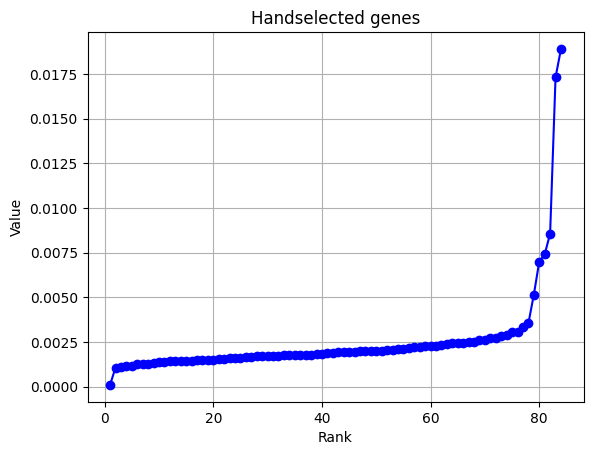

In [87]:
values = np.sort(abs_mean_attributions_handselected)
ranks = np.arange(1, len(values) + 1)

plt.plot(ranks, values, marker='o', linestyle='-', color='blue')
plt.xlabel('Rank')
plt.ylabel('Value')
plt.title('Handselected genes')
plt.grid(True)
plt.show()

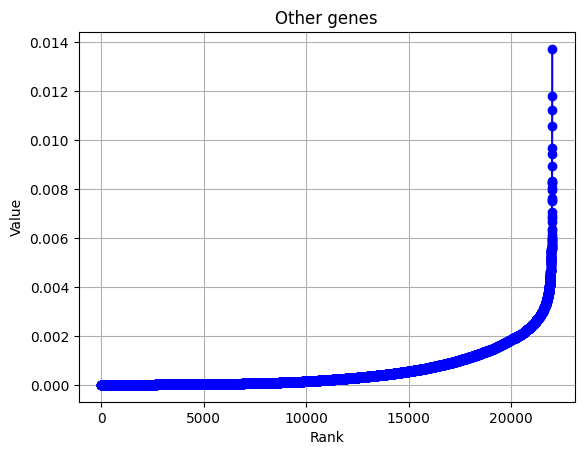

In [88]:
values = np.sort(abs_mean_attributions_others)
ranks = np.arange(1, len(values) + 1)

plt.plot(ranks, values, marker='o', linestyle='-', color='blue')
plt.xlabel('Rank')
plt.ylabel('Value')
plt.title('Other genes')
plt.grid(True)
plt.show()

In [89]:
# TODO plot these in one plot: seaborn scatterplot hue

In [141]:
# check if the genes with higher mean attribution are among the top 20 features shown in shap plot

print('Handselected genes:')
for i in genes_higher_attr_handselected:
    print(i, i in top_20_feature_names_shap)  # CD9 and SPINK2 are not among top 20
    
print('Other genes:')
for i in genes_higher_attr_others:
    print(i, i in top_20_feature_names_shap)  # these are all True => all among top 20

Handselected genes:
ENSG00000135218_CD36 True
ENSG00000117091_CD48 True
ENSG00000114013_CD86 True
ENSG00000010278_CD9 False
ENSG00000128040_SPINK2 False
ENSG00000072274_TFRC True
Other genes:
ENSG00000236824_BCYRN1 True
ENSG00000105205_CLC True
ENSG00000105472_CLEC11A True
ENSG00000077984_CST7 True
ENSG00000184897_H1FX True
ENSG00000244734_HBB True
ENSG00000100097_LGALS1 True
ENSG00000125148_MT2A True
ENSG00000245532_NEAT1 True
ENSG00000183971_NPW True
ENSG00000122862_SRGN True
ENSG00000265972_TXNIP True


In [142]:
# compute gini index of mean attributions and include in plot below
def gini(arr):    # range from 0 (total equality) to 1 (absolute inequality)
    ## first sort
    sorted_arr = arr.copy()
    sorted_arr.sort()
    n = arr.size
    coef_ = 2. / n
    const_ = (n + 1.) / n
    weighted_sum = sum([(i+1)*yi for i, yi in enumerate(sorted_arr)])
    return coef_*weighted_sum/(sorted_arr.sum()) - const_

print(gini(abs_mean_attributions_handselected))
print(gini(abs_mean_attributions_others))


# TODO put plots into one with same y-axis scale

0.3404617764448923
0.6622982225978515


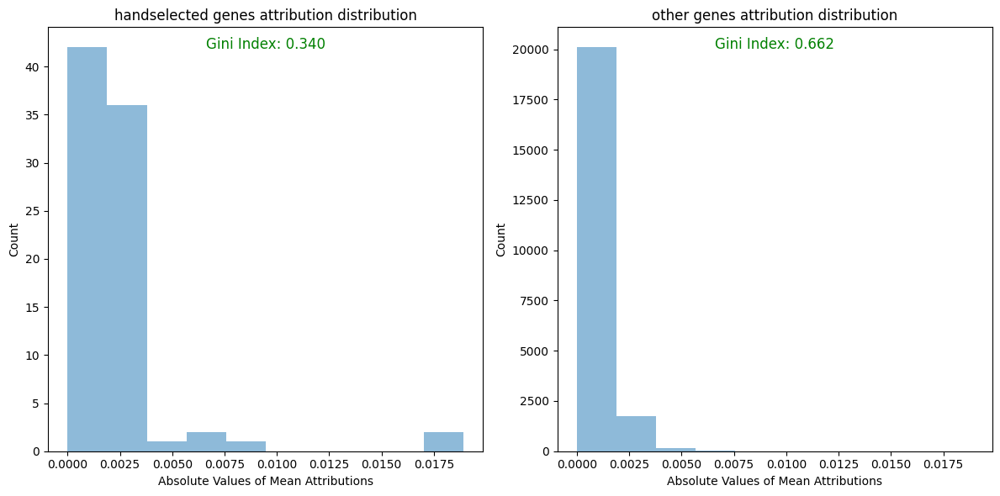

In [92]:
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 6))

ax1.hist(abs_mean_attributions_handselected, bins=distribution[1], alpha=0.5)  # bins=distribution[1]  # bins=log_bins
# ax1.set_xscale('log')
ax1.text(0.5, 0.95, f'Gini Index: {gini(abs_mean_attributions_handselected):.3f}', transform=ax1.transAxes, ha='center', color='green', fontsize=12)

ax1.set_xlabel('Absolute Values of Mean Attributions')
ax1.set_ylabel('Count')
ax1.set_title('handselected genes attribution distribution')

ax2.hist(abs_mean_attributions_others, bins=distribution[1], alpha=0.5)
# ax2.set_xscale('log')
ax2.text(0.5, 0.95, f'Gini Index: {gini(abs_mean_attributions_others):.3f}', transform=ax2.transAxes, ha='center', color='green', fontsize=12)

ax2.set_xlabel('Absolute Values of Mean Attributions')
ax2.set_ylabel('Count')
ax2.set_title('other genes attribution distribution')

plt.tight_layout()
plt.show()

(0.0, 21098.7)


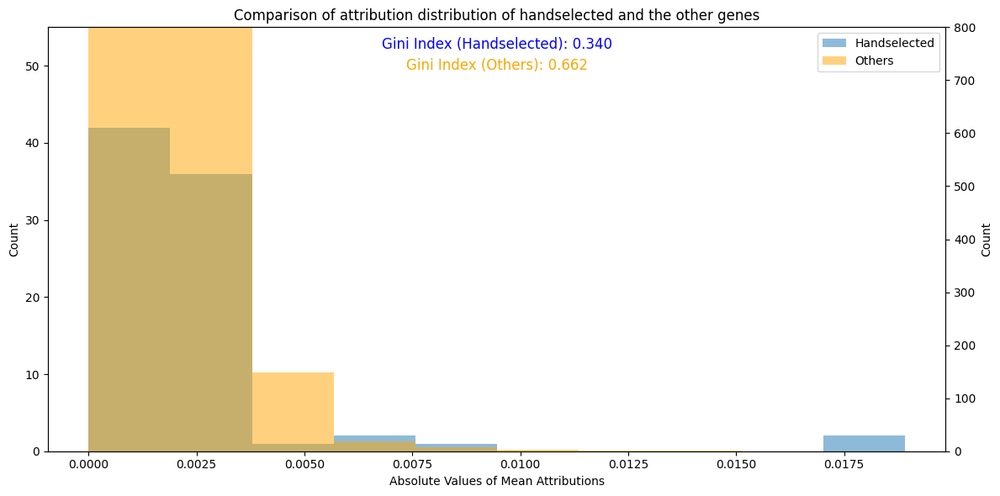

In [93]:
fig, ax = plt.subplots(figsize=(12, 6))

ax.hist(abs_mean_attributions_handselected, bins=distribution[1], alpha=0.5, label='Handselected')
ax.set_xlabel('Absolute Values of Mean Attributions')
ax.set_ylabel('Count')
ax.set_title('Comparison of attribution distribution of handselected and the other genes')

# Create a twin axis for the second histogram
ax2 = ax.twinx()

ax2.hist(abs_mean_attributions_others, bins=distribution[1], alpha=0.5, color='orange', label='Others')
ax2.set_ylabel('Count')

# Adjust the y-axis limits of the twin Axes to match the primary Axes
# ax.set_ylim(ax2.get_ylim())
print(ax2.get_ylim())
ax.set_ylim((0,55))
ax2.set_ylim((0,800))

# Add legend
handles, labels = ax.get_legend_handles_labels()
handles2, labels2 = ax2.get_legend_handles_labels()
ax.legend(handles + handles2, labels + labels2, loc='upper right')

# Add Gini index labels
ax.text(0.5, 0.95, f'Gini Index (Handselected): {gini(abs_mean_attributions_handselected):.3f}', transform=ax.transAxes, ha='center', color='blue', fontsize=12)
ax2.text(0.5, 0.90, f'Gini Index (Others): {gini(abs_mean_attributions_others):.3f}', transform=ax2.transAxes, ha='center', color='orange', fontsize=12)

# Adjust the layout and display the plot
plt.tight_layout()
plt.show()

In [ ]:
# TODO same density for both plots (same area of histograms) -> adjusts y-axes

In [94]:
# analyze svd components distr.

mean_svd_contr = np.mean(np.abs(svd_comp_norm), axis=0)
top_20_indices = np.argsort(mean_svd_contr)[-20:][::-1]

top_20_mean_contributions = mean_svd_contr[top_20_indices]
top_features_svd = []

# Print the top 20 columns and their mean contributionsb
print("Top 20 Columns with Highest Mean Contributions to SVDs:")
for column_index, mean_contribution in zip(top_20_indices, top_20_mean_contributions):
    print("Column: {}, Mean Contribution: {}".format(all_genes[column_index], mean_contribution))
    top_features_svd.append(all_genes[column_index])
# top_features_svd

Top 20 Columns with Highest Mean Contributions to SVDs:
Column: ENSG00000183971_NPW, Mean Contribution: 0.05371263880033439
Column: ENSG00000265972_TXNIP, Mean Contribution: 0.05304467293306914
Column: ENSG00000184897_H1FX, Mean Contribution: 0.050361890191894076
Column: ENSG00000100097_LGALS1, Mean Contribution: 0.04478373777794786
Column: ENSG00000244734_HBB, Mean Contribution: 0.04448112404531912
Column: ENSG00000170891_CYTL1, Mean Contribution: 0.04375964055004289
Column: ENSG00000125148_MT2A, Mean Contribution: 0.04370106634189597
Column: ENSG00000124766_SOX4, Mean Contribution: 0.043334829030293065
Column: ENSG00000196565_HBG2, Mean Contribution: 0.04226584332002403
Column: ENSG00000136997_MYC, Mean Contribution: 0.04127837825257075
Column: ENSG00000105472_CLEC11A, Mean Contribution: 0.03861755490861185
Column: ENSG00000143013_LMO4, Mean Contribution: 0.03811856453020823
Column: ENSG00000147872_PLIN2, Mean Contribution: 0.03761395295751413
Column: ENSG00000137193_PIM1, Mean Contr

In [95]:
# compare resulting genes
for i in top_features_svd:
    if i in top_feature_names_shap:
        print(i, 'among top 20 shap features')
    
    elif i in genes_higher_attr_handselected:
        print(i, 'among handselected genes with highest attributions')
    elif i in genes_higher_attr_others:
        print(i, 'among other genes with highest attributions')
    else:
        print(i)

ENSG00000183971_NPW among top 20 shap features
ENSG00000265972_TXNIP among top 20 shap features
ENSG00000184897_H1FX among top 20 shap features
ENSG00000100097_LGALS1 among top 20 shap features
ENSG00000244734_HBB among top 20 shap features
ENSG00000170891_CYTL1 among top 20 shap features
ENSG00000125148_MT2A among top 20 shap features
ENSG00000124766_SOX4 among top 20 shap features
ENSG00000196565_HBG2
ENSG00000136997_MYC
ENSG00000105472_CLEC11A among top 20 shap features
ENSG00000143013_LMO4
ENSG00000147872_PLIN2
ENSG00000137193_PIM1
ENSG00000101745_ANKRD12
ENSG00000160888_IER2
ENSG00000167552_TUBA1A
ENSG00000105205_CLC among top 20 shap features
ENSG00000236824_BCYRN1 among top 20 shap features
ENSG00000245532_NEAT1 among top 20 shap features
